In [171]:
import xarray as xr
import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np
import os
from sympy import *
import cartopy.crs as ccrs
import cartopy as cart
import glob

plt.rcParams['figure.dpi'] = 300

import warnings
warnings.filterwarnings('ignore')

os.environ['HDF5_USE_FILE_LOCKING'] = "FALSE"
mpl.rcParams['axes.titlesize' ] = 28
mpl.rcParams['axes.labelsize' ] = 22
mpl.rcParams['xtick.labelsize'] = 20
mpl.rcParams['ytick.labelsize'] = 20
mpl.rcParams["figure.figsize" ] = (30,12)
from cycler import cycler
#mpl.rcParams['axes.prop_cycle'] = cycler(color='bgrcmyk')
mpl.rcParams['axes.prop_cycle'] = cycler('color', ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf'])

### Data description:

- CESM2W6 (CESM2-WACCM6) 1.5 and 2 degree peak-shaving simulations, each with two ensembles. (Questions: "the two WACCM6 ensemble members from the historical simulation" from the Tilmes paper)
- PK-1.5 simulations are provided from 2040 to 2100, but PK-2.0 simulations are from 2032-2100. In Timles' paper, the year ranges of two peak-shavings are reversed. In the real simulations, the year starting SAI in PK-1.5 simulations shall be earlier than that in PK-2.0 simulations as the tmeperature of 1.5 above PI reaches earlier than 2 degree above PI in the SSP534OS simulation

In [2]:
### CESM2 result directory

dir_cesm2 = "/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm"
dir_esgf = dir_cesm2 + "/cesm2-waccm-esgf/"
GeoPK20_case1 = "b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001"
GeoPK20_case2 = "b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002"

GeoPK15_case1 = "b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001"
GeoPK15_case2 = "b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002"

In [3]:
### E3SM SC cases
Dir_Geo_E3SM = "/gpfs/alpine/cli137/world-shared/mxu/e3sm_geo/"
E3SM_Geo_PK20 = "20220528.PkShav1.5_GEOENG_SSP534OS_RUBISCO_NEWSFLU_CNPCTCSSP_OIBGC.ne30_oECv3.miller"
E3SM_Geo_534S = "20220522.GEOENG_SSP534OS_RUBISCO_NEWSFLU_CNPCTCSSP_OIBGC.ne30_oECv3.miller"
E3SM_Geo_HIST = "20220418.GEOENG_HIST_RUBISCO_NEWSFLU_CNPCTC20TR_OIBGC.ne30_oECv3.miller"

In [9]:
### Common functions to deal with the output time and land_units


def open_files (DataSource, SceName, TabName, CaseName, VarName):
# read files from three different data source, ncar(cesm2-waccm), esgf, and e3sm
# return xarray dataset
    import os
    if DataSource == 'ncar':
        TopDir = dir_cesm2
        
        if TabName == 'Lmon':
            FileTemp = TopDir + "/{}/land_monthly/{}.clm2.h0.{}.204001-210012.nc".format(CaseName, CaseName, VarName)
        elif TabName == 'Amon':
            FileTemp = TopDir + "/{}/atmos_monthly/{}.cam.h0.{}.204001-210012.nc".format(CaseName, CaseName, VarName)
        if not os.path.exists(FileTemp):
            FileTemp = FileTemp.replace('204001-210012', '*')
    if DataSource == 'esgf':
        TopDir = dir_esgf
        FileTemp = TopDir + "{}/r1i1p1f1/{}/{}/gn/*/*.nc".format(SceName, TabName, VarName)
        FileList = glob.glob(FileTemp)
        
        filsel=None
        versel=0
        for fl in FileList:
            tmparr = fl.split('/')
            if int(tmparr[tmparr.index('gn')+1][1:]) >= versel:
                filsel = tmparr[tmparr.index('gn')+1]
                versel = int(tmparr[tmparr.index('gn')+1][1:])
        if filsel:
            FileTemp = TopDir + "{}/r1i1p1f1/{}/{}/gn/{}/*.nc".format(SceName, TabName, VarName, filsel)

    if DataSource == 'e3sm':
        TopDir = Dir_Geo_E3SM
        
        if TabName == 'Lmon':
            FileTemp = TopDir + "{}/rgr/lnd/{}_*.nc".format(CaseName, VarName)
        elif TabName == 'Amon':
            FileTemp = TopDir + "{}/rgr/atm/{}_*.nc".format(CaseName, VarName)
        elif TabName == 'fx':
            FileTemp = TopDir + "{}/rgr/fx/{}_*.nc".format(CaseName, VarName)

    print (FileTemp)            
    if '*' in FileTemp:    
        ds = xr.open_mfdataset(FileTemp)
    else:
        ds = xr.open_dataset(FileTemp)
        
    return ds

def gm_by_area_wght(ds, vname, OpType, LandInfo, area, landfrac, TabName, TimeShift=True):
# get the global mean weighted by area, ds is the xarray data array.

# time shift is needed for the raw outputs of cesm and e3sm, as time in time array is
# generally is the time at the end of integration for dumping history files.
# LandInfo: true, the xarray data array or data set consisting of the area and land fraction.
    
    if TimeShift:
        if TabName == 'Lmon':
            ds["time0"] = ds.time_bounds[:,0].dt.ceil('D')
        if TabName == 'Amon':
            try:
                ds["time0"] = ds.time_bnds[:,0]
            except:
                ds["time0"] = ds.time_bounds[:,0].dt.ceil('D')

        dd = ds.set_index(time="time0")
    else:
        dd = ds 
        

    dayspermon=[31, 28, 31, 30, 31, 30, 31, 31, 30, 31, 30, 31]
    dpm = np.zeros(dd.time.size)

    for j in range (dd.time.size):
        k = j%12
        dpm[j] = dayspermon[k]
    
    if LandInfo:
        if TabName == 'Amon':
            xarea = dd.areacella
        else:
            xarea = dd.area
    else:
        xarea = area.areacella
    
    if LandInfo:
        if TabName == 'Amon':
            xlandfrac = dd.sftlf
        else:
            xlandfrac = dd.landfrac
    else:
        xlandfrac = landfrac.sftlf
    
    xrdpm = xr.DataArray(data=dpm, 
              dims=["time"],
              coords=dict(time=dd.time.values,),
              attrs=dict(description="days per months", units="days",),)

    # if the LandInfo == True, the area and fraction data are from the ds, so will be no problem, but when it is false, it will cause problem
    if OpType == 'sum':
        
        if TabName == 'Amon':
            TsGBL = (dd[vname] * xarea.values[None,:,:] * 1.e6             * 86400 * xrdpm * 1.e-15).sum(dim=("lat", "lon")).groupby('time.year').sum('time')            
        else:
            if LandInfo:
                TsGBL = (dd[vname] * xarea * 1.e6 * xlandfrac * 86400 * xrdpm * 1.e-15).sum(dim=("lat", "lon")).groupby('time.year').sum('time')
            else:
                TsGBL = (dd[vname] * xarea.values * 1.e6 * xlandfrac.values * 86400 * xrdpm * 1.e-15).sum(dim=("lat", "lon")).groupby('time.year').sum('time')
            
        
    elif OpType == 'avg':
        if LandInfo:           
            if TabName == 'Amon':
                temp = (dd[vname] * xarea * 1.e6             * xrdpm).sum(dim=("lat", "lon")) / (xarea * 1.e6            ).sum(dim=("lat", "lon"), skipna=True)
            else:
                temp = (dd[vname] * xarea * 1.e6 * xlandfrac * xrdpm).sum(dim=("lat", "lon")) / (xarea * 1.e6 * xlandfrac).sum(dim=("lat", "lon"), skipna=True)

        else:
            if TabName == 'Amon':
                temp = (dd[vname] * xarea.values[None,:,:] * 1.e6                              * xrdpm).sum(dim=("lat", "lon")) / (xarea * 1.e6                   ).sum(dim=("lat", "lon"), skipna=True)        
            else:
                
                temp = (dd[vname] * xarea.values[None,:,:] * 1.e6 * xlandfrac.values[None,:,:] * xrdpm).sum(dim=("lat", "lon")) / (xarea * 1.e6 * xlandfrac.values).sum(dim=("lat", "lon"), skipna=True)   
                
        TsGBL = temp.groupby('time.year').sum('time') / 365.
               
    return TsGBL

def plot_ts_diff(VarList, CumDiff, LabList, Ylabel, VarE3SM=[]):
    
    if CumDiff:
        fig, faxs = plt.subplots(1,3)
    else:
        fig, faxs = plt.subplots(1,3)

    axs = faxs.flatten()
    #ax2 = ax.twinx()
    
    LnColors_1 = ['#17becf', '#17becf', '#ff7f0e', '#ff7f0e', 'k'] 
    for i, var in enumerate(VarList):
        var.plot(ax=axs[0], label=LabList[i], color=LnColors_1[i])


    LnColors_2 = ['#9467bd', 'b']
    if VarE3SM:
        e3smlab = ['E3SMSC-Geo-2.0', 'E3SMSC-SSP534OS']
        for i, var in enumerate(VarE3SM):
            
            if 'nbp' in Ylabel:
                var[1:].plot(ax=axs[0], label=e3smlab[i], color=LnColors_2[i])
            else:               
                var.plot(ax=axs[0], label=e3smlab[i], color=LnColors_2[i])
    for i, var in enumerate(VarList[:-1]):
        if CumDiff:
            (var-VarList[-1]).plot.line('--', color=LnColors_1[i], linewidth=3, ax=axs[1])
            (var-VarList[-1]).cumsum().plot.line('--', label=LabList[i], color=LnColors_1[i], linewidth=3, ax=axs[2])
        else:
            (var-VarList[-1]).plot.line('--', color=LnColors_1[i], linewidth=3, ax=axs[1])

    if VarE3SM:
        e3smlab = ['E3SMSC-Geo-2.0', 'E3SMSC-SSP534OS']
        for i, var in enumerate(VarE3SM[:-1]):
            if CumDiff:
                
                if 'nbp' in Ylabel:
                    (var-VarE3SM[-1])[1:].cumsum().plot.line('--', label=e3smlab[i], color=LnColors_2[i], linewidth=3, ax=axs[2])
                    (var-VarE3SM[-1])[1:].plot.line('--', color=LnColors_2[i], linewidth=3, ax=axs[1])

                else:
                    (var-VarE3SM[-1]).cumsum().plot.line('--', label=e3smlab[i], color=LnColors_2[i], linewidth=3, ax=axs[2])
                    (var-VarE3SM[-1]).plot.line('--', color=LnColors_2[i], linewidth=3, ax=axs[1])

            else:
                (var-VarE3SM[-1]).plot.line('--', color=LnColors_2[i], linewidth=3, ax=axs[1])


    #ax2.tick_params(axis='y', labelcolor='blue')
    #ax2.axhline(y=0.0, color='b', linestyle='--')
    
    axs[0].legend(prop={'size': 12})
    axs[2].legend(prop={'size': 12})
    
    axs[0].set_ylabel(Ylabel, fontsize=20)
    if CumDiff:
        axs[1].set_ylabel(Ylabel+'Diff', fontsize=20)
        axs[2].set_ylabel('cum'+Ylabel+'Diff', fontsize=20)
    else:
        axs[1].set_ylabel(Ylabel+'Diff', fontsize=20)
        axs[2].axis('off')
        
def plot_ts(SecName, TabName, OpType, Vname_NCAR, Vname_ESGF, Sca_NCAR, Sca_ESGF, Cumdiff, Ylabel, noLimit = False, Vname_E3SM=None, Sca_E3SM=None, Fct_NCAR=0.0, Fct_ESGF=0.0, Fct_E3SM=0.0, SkipPlot=False):
    opstr = ['+', '-', '*', '/']
## NCAR
    if any (e in Vname_NCAR for e in opstr):
        # sympy 
        #StrVname_NCAR.translate({ord(c):' ' for c in '+-*/'})
        Sym_Expr_NCAR = sympify(Vname_NCAR)
        FreeSymb_NCAR = list(Sym_Expr_NCAR.free_symbols)
        fNCAR = lambdify(FreeSymb_NCAR, Sym_Expr_NCAR, "numpy") 
        
        dsTmp15_1 = []
        dsTmp15_2 = []
        dsTmp20_1 = []
        dsTmp20_2 = []
        for s in FreeSymb_NCAR:
            dsTmp15_1.append(open_files('ncar', SecName.upper()+'-PK',   TabName, GeoPK15_case1, s.name))
            dsTmp20_1.append(open_files('ncar', SecName.upper()+'-PK',   TabName, GeoPK20_case1, s.name))
            dsTmp15_2.append(open_files('ncar', SecName.upper()+'-PK',   TabName, GeoPK15_case2, s.name))
            dsTmp20_2.append(open_files('ncar', SecName.upper()+'-PK',   TabName, GeoPK20_case2, s.name))

            
        dsVar15_1 = dsTmp15_1[0].copy()
        dsVar15_1["uniqName"] = fNCAR(*[ds[s.name] for s, ds in zip(FreeSymb_NCAR,dsTmp15_1)])
        
        dsVar15_2 = dsTmp15_2[0].copy()
        dsVar15_2["uniqName"] = fNCAR(*[ds[s.name] for s, ds in zip(FreeSymb_NCAR,dsTmp15_2)])
        
        dsVar20_1 = dsTmp20_1[0].copy()
        dsVar20_1["uniqName"] = fNCAR(*[ds[s.name] for s, ds in zip(FreeSymb_NCAR,dsTmp20_1)])

        dsVar20_2 = dsTmp20_2[0].copy()
        dsVar20_2["uniqName"] = fNCAR(*[ds[s.name] for s, ds in zip(FreeSymb_NCAR,dsTmp20_2)])

        
        if not noLimit:
            dsVar15_1["uniqName"] = dsVar15_1["uniqName"].where(np.logical_and(dsVar15_1["uniqName"] > 0, dsVar15_1["uniqName"] < 1)) 
            dsVar20_1["uniqName"] = dsVar20_1["uniqName"].where(np.logical_and(dsVar20_1["uniqName"] > 0, dsVar20_1["uniqName"] < 1)) 
            dsVar15_2["uniqName"] = dsVar15_2["uniqName"].where(np.logical_and(dsVar15_2["uniqName"] > 0, dsVar15_2["uniqName"] < 1)) 
            dsVar20_2["uniqName"] = dsVar20_2["uniqName"].where(np.logical_and(dsVar20_2["uniqName"] > 0, dsVar20_2["uniqName"] < 1)) 
            
            

    else:
        dsVar15_1 = open_files('ncar', SecName.upper()+'-PK',   TabName, GeoPK15_case1, Vname_NCAR)
        dsVar20_1 = open_files('ncar', SecName.upper()+'-PK',   TabName, GeoPK20_case1, Vname_NCAR)
        dsVar15_2 = open_files('ncar', SecName.upper()+'-PK',   TabName, GeoPK15_case2, Vname_NCAR)
        dsVar20_2 = open_files('ncar', SecName.upper()+'-PK',   TabName, GeoPK20_case2, Vname_NCAR)

## ESGF
    if any (e in Vname_ESGF for e in opstr):
        Sym_Expr_ESGF = sympify(Vname_ESGF)
        FreeSymb_ESGF = list(Sym_Expr_ESGF.free_symbols)
        fESGF = lambdify(FreeSymb_ESGF, Sym_Expr_ESGF, "numpy")

        dsTmpbs = []
        for s in FreeSymb_ESGF:
            dsTmpbs.append(open_files('esgf', SecName.lower()+'-over', TabName, '',           s.name))
        dsVarbs = dsTmpbs[0].copy()
        dsVarbs["uniqName"] = fESGF(*[ds[s.name] for s, ds in zip(FreeSymb_ESGF,dsTmpbs)])        
        if not noLimit:
            dsVarbs["uniqName"] = dsVarbs["uniqName"].where(np.logical_and(dsVarbs["uniqName"] > 0, dsVarbs["uniqName"] < 1)) 

 
    else:
        if Vname_ESGF == 'tas':
            dsVarbs = open_files('esgf', SecName.lower()+'-over', 'Amon', '',           Vname_ESGF)
        else:
            dsVarbs = open_files('esgf', SecName.lower()+'-over', TabName, '',           Vname_ESGF)


    if Vname_E3SM: 
        if any (e in Vname_E3SM for e in opstr):
            Sym_Expr_E3SM = sympify(Vname_E3SM)
            FreeSymb_E3SM = list(Sym_Expr_E3SM.free_symbols)
            fE3SM = lambdify(FreeSymb_E3SM, Sym_Expr_E3SM, "numpy")

            dsTmpbs = []
            dsTmp20 = []
            for s in FreeSymb_E3SM:
                dsTmp20.append(open_files('e3sm', SecName.lower()+'-over', TabName, E3SM_Geo_PK20, s.name))
                dsTmpbs.append(open_files('e3sm', SecName.lower()+'-over', TabName, E3SM_Geo_534S, s.name))

            dsVar20e = dsTmp20[0].copy()
            dsVarbse = dsTmpbs[0].copy()
            dsVar20e["uniqName"] = fE3SM(*[ds[s.name] for s, ds in zip(FreeSymb_E3SM,dsTmp20)])
            dsVarbse["uniqName"] = fE3SM(*[ds[s.name] for s, ds in zip(FreeSymb_E3SM,dsTmpbs)])
        
            if not noLimit:
                dsVar20e["uniqName"] = dsVar20e["uniqName"].where(np.logical_and(dsVar20e["uniqName"] > 0, dsVar20e["uniqName"] < 1))
                dsVarbse["uniqName"] = dsVarbse["uniqName"].where(np.logical_and(dsVarbse["uniqName"] > 0, dsVarbse["uniqName"] < 1))
 
        else:
            dsVar20e = open_files('e3sm', SecName.lower()+'-over', TabName, E3SM_Geo_PK20, Vname_E3SM)
            dsVarbse = open_files('e3sm', SecName.lower()+'-over', TabName, E3SM_Geo_534S, Vname_E3SM)
        
    #mxu read in the cmip6 areacella ana sftlt
    
    areacella = open_files('esgf', SecName.lower()+'-over', 'fx', '', 'areacella')*1.e-6
    sftlf = open_files('esgf', SecName.lower()+'-over', 'fx', '', 'sftlf') *1.e-2
        
    if any (e in Vname_NCAR for e in opstr):
        
        if TabName == 'Lmon':
            Var15_1_TsGBL = gm_by_area_wght(dsVar15_1, 'uniqName', OpType, True, None, None, TabName) * Sca_NCAR + Fct_NCAR # gC/m2 to kgC/m2
            Var20_1_TsGBL = gm_by_area_wght(dsVar20_1, 'uniqName', OpType, True, None, None, TabName) * Sca_NCAR + Fct_NCAR
            Var15_2_TsGBL = gm_by_area_wght(dsVar15_2, 'uniqName', OpType, True, None, None, TabName) * Sca_NCAR + Fct_NCAR  # gC/m2 to kgC/m2
            Var20_2_TsGBL = gm_by_area_wght(dsVar20_2, 'uniqName', OpType, True, None, None, TabName) * Sca_NCAR + Fct_NCAR
        else:
            Var15_1_TsGBL = gm_by_area_wght(dsVar15_1, 'uniqName', OpType, False, areacella, sftlf, TabName) * Sca_NCAR + Fct_NCAR # gC/m2 to kgC/m2
            Var20_1_TsGBL = gm_by_area_wght(dsVar20_1, 'uniqName', OpType, False, areacella, sftlf, TabName) * Sca_NCAR + Fct_NCAR
            Var15_2_TsGBL = gm_by_area_wght(dsVar15_2, 'uniqName', OpType, False, areacella, sftlf, TabName) * Sca_NCAR + Fct_NCAR # gC/m2 to kgC/m2
            Var20_2_TsGBL = gm_by_area_wght(dsVar20_2, 'uniqName', OpType, False, areacella, sftlf, TabName) * Sca_NCAR + Fct_NCAR           

    else:
        if TabName == 'Lmon':
            Var15_1_TsGBL = gm_by_area_wght(dsVar15_1, Vname_NCAR, OpType, True, None, None, TabName) * Sca_NCAR + Fct_NCAR # gC/m2 to kgC/m2
            Var20_1_TsGBL = gm_by_area_wght(dsVar20_1, Vname_NCAR, OpType, True, None, None, TabName) * Sca_NCAR + Fct_NCAR
            Var15_2_TsGBL = gm_by_area_wght(dsVar15_2, Vname_NCAR, OpType, True, None, None, TabName) * Sca_NCAR + Fct_NCAR # gC/m2 to kgC/m2
            Var20_2_TsGBL = gm_by_area_wght(dsVar20_2, Vname_NCAR, OpType, True, None, None, TabName) * Sca_NCAR + Fct_NCAR
        else:
            Var15_1_TsGBL = gm_by_area_wght(dsVar15_1, Vname_NCAR, OpType, False, areacella, sftlf, TabName) * Sca_NCAR + Fct_NCAR # gC/m2 to kgC/m2
            Var20_1_TsGBL = gm_by_area_wght(dsVar20_1, Vname_NCAR, OpType, False, areacella, sftlf, TabName) * Sca_NCAR + Fct_NCAR
            Var15_2_TsGBL = gm_by_area_wght(dsVar15_2, Vname_NCAR, OpType, False, areacella, sftlf, TabName) * Sca_NCAR + Fct_NCAR # gC/m2 to kgC/m2
            Var20_2_TsGBL = gm_by_area_wght(dsVar20_2, Vname_NCAR, OpType, False, areacella, sftlf, TabName) * Sca_NCAR + Fct_NCAR

    if any (e in Vname_ESGF for e in opstr):
        Varbs_TsGBL = gm_by_area_wght(dsVarbs, 'uniqName', OpType, False, areacella, sftlf, TabName, TimeShift=False) * Sca_ESGF + Fct_ESGF
    else:
        Varbs_TsGBL = gm_by_area_wght(dsVarbs, Vname_ESGF, OpType, False, areacella, sftlf, TabName, TimeShift=False) * Sca_ESGF + Fct_ESGF

    if Vname_E3SM:
        E3SM_areacella = open_files('e3sm', SecName.lower()+'-over', 'fx', E3SM_Geo_HIST, 'areacella')*1.e-6
        E3SM_sftlf = open_files('e3sm', SecName.lower()+'-over', 'fx', E3SM_Geo_HIST, 'sftlf')*1.e-2
        
        if any (e in Vname_E3SM for e in opstr):
            Varbse_TsGBL = gm_by_area_wght(dsVarbse, 'uniqName', OpType, False, E3SM_areacella, E3SM_sftlf, TabName, TimeShift=True) * Sca_E3SM + Fct_E3SM
            Var20e_TsGBL = gm_by_area_wght(dsVar20e, 'uniqName', OpType, False, E3SM_areacella, E3SM_sftlf, TabName, TimeShift=True) * Sca_E3SM + Fct_E3SM
            


        else:
            Varbse_TsGBL = gm_by_area_wght(dsVarbse, Vname_E3SM, OpType, False, E3SM_areacella, E3SM_sftlf, TabName, TimeShift=True) * Sca_E3SM + Fct_E3SM
            Var20e_TsGBL = gm_by_area_wght(dsVar20e, Vname_E3SM, OpType, False, E3SM_areacella, E3SM_sftlf, TabName, TimeShift=True) * Sca_E3SM + Fct_E3SM
            

    if Vname_E3SM:
        if not SkipPlot:
            plot_ts_diff([Var15_1_TsGBL, Var15_2_TsGBL, Var20_1_TsGBL, Var20_2_TsGBL, Varbs_TsGBL], Cumdiff, ['CESM2W6-Geo-1.5-1', 'CESM2W6-Geo-1.5-2', 'CESM2W6-Geo-2.0-1', 'CESM2W6-Geo-2.0-2', 'CESM2W6-SSP534OS'], Ylabel, 
                     VarE3SM=[Var20e_TsGBL, Varbse_TsGBL])
        return [Var15_1_TsGBL, Var15_2_TsGBL, Var20_1_TsGBL, Var20_2_TsGBL, Varbs_TsGBL, Var20e_TsGBL, Varbse_TsGBL]
    else:
        if not SkipPlot:
            plot_ts_diff([Var15_1_TsGBL, Var15_2_TsGBL, Var20_1_TsGBL, Var20_2_TsGBL, Varbs_TsGBL], Cumdiff, ['CESM2W6-Geo-1.5-1', 'CESM2W6-Geo-1.5-2', 'CESM2W6-Geo-2.0-1', 'CESM2W6-Geo-2.0-2', 'CESM2W6-SSP534OS'], Ylabel)
        return [Var15_1_TsGBL, Var15_2_TsGBL, Var20_1_TsGBL, Var20_2_TsGBL, Varbs_TsGBL]


In [5]:

def _plot_geomap(daVar15_1, daVar15_2, daVar20_1, daVar20_2, daVarbsc, Sca_NCAR, Sca_ESGF, OrigLevs, DiffLevs, VarName, Fct_NCAR=0.0, Fct_ESGF=0.0, daVarbse=None, daVar20e=None, Sca_E3SM=None, Fct_E3SM=0.0, MaskOcean=False):
    
    # now all data are in:
    if Sca_E3SM:
        fig, ax = plt.subplots(7, 2, subplot_kw=dict(projection=ccrs.Robinson(central_longitude=-180.)))
        fig.set_size_inches(18, 33)

    else:
        fig, ax = plt.subplots(5, 2, subplot_kw=dict(projection=ccrs.Robinson(central_longitude=-180.)))
        fig.set_size_inches(18, 28)

        
    MapTitles = ['(a) CESM2W6-SSP534OS (baseline)', '', '(b) CESM2W6-Geo-1.5-1', '(c) CESM2W6-Geo-1.5-1 minus baseline', '(d) CESM2W6-Geo-1.5-2', 'CESM2W6-Geo-1.5-2 minus baseline',
                                                        '(e) CESM2W6-Geo-2.0-1', '(f) CESM2W6-Geo-2.0-1 minus baseline', '(g) CESM2W6-Geo-2.0-2', 'CESM2W6-Geo-2.0-2 minus baseline',
                 '(h) E3SMSC-SSP534OS (baseline)', '(j) E3SMSC-SSP534OS minus CESM2W6',  '(k) E3SMSC-Geo-2.0',    '(l) E3SMSC-Geo-2.0 minus baseline']
    fo1 = (daVarbsc*Sca_ESGF+Fct_ESGF).plot(ax=ax[0,0], transform=ccrs.PlateCarree(), levels=OrigLevs, add_colorbar=False, cmap='viridis', extend='both')
    ax[0,1].axis('off')
    
    (daVar15_1*Sca_NCAR+Fct_NCAR).plot(ax=ax[1,0], transform=ccrs.PlateCarree(), add_colorbar=False, levels=OrigLevs, cmap='viridis',extend='both')
    (daVar15_2*Sca_NCAR+Fct_NCAR).plot(ax=ax[2,0], transform=ccrs.PlateCarree(), add_colorbar=False, levels=OrigLevs, cmap='viridis',extend='both')
    (daVar20_1*Sca_NCAR+Fct_NCAR).plot(ax=ax[3,0], transform=ccrs.PlateCarree(), add_colorbar=False, levels=OrigLevs, cmap='viridis',extend='both')
    (daVar20_2*Sca_NCAR+Fct_NCAR).plot(ax=ax[4,0], transform=ccrs.PlateCarree(), add_colorbar=False, levels=OrigLevs, cmap='viridis',extend='both')

    fd1 = ((daVar15_1*Sca_NCAR+Fct_NCAR)-(daVarbsc*Sca_ESGF+Fct_ESGF)).plot(ax=ax[1,1], transform=ccrs.PlateCarree(),add_colorbar=False, levels=DiffLevs, cmap='bwr', extend='both')
    ((daVar15_2*Sca_NCAR+Fct_NCAR)-(daVarbsc*Sca_ESGF+Fct_ESGF)).plot(ax=ax[2,1], transform=ccrs.PlateCarree(),add_colorbar=False, levels=DiffLevs, cmap='bwr', extend='both')
    ((daVar20_1*Sca_NCAR+Fct_NCAR)-(daVarbsc*Sca_ESGF+Fct_ESGF)).plot(ax=ax[3,1], transform=ccrs.PlateCarree(),add_colorbar=False, levels=DiffLevs, cmap='bwr', extend='both')
    ((daVar20_2*Sca_NCAR+Fct_NCAR)-(daVarbsc*Sca_ESGF+Fct_ESGF)).plot(ax=ax[4,1], transform=ccrs.PlateCarree(),add_colorbar=False, levels=DiffLevs, cmap='bwr', extend='both')

    if Sca_E3SM: 
        (daVarbse*Sca_E3SM+Fct_E3SM).plot(ax=ax[5,0], transform=ccrs.PlateCarree(), add_colorbar=False, levels=OrigLevs, cmap='viridis',extend='both')
        #ax[5,1].axis('off')
        
        daVarbse_interp = daVarbse.interp(lon=daVarbsc.lon, lat=daVarbsc.lat)
                
        ((daVarbse_interp*Sca_E3SM+Fct_E3SM)-(daVarbsc*Sca_ESGF+Fct_ESGF)).plot(ax=ax[5,1], transform=ccrs.PlateCarree(), add_colorbar=False, levels=DiffLevs, cmap='bwr', extend='both')

        (daVar20e*Sca_E3SM+Fct_E3SM).plot(ax=ax[6,0], transform=ccrs.PlateCarree(), add_colorbar=False, levels=OrigLevs, cmap='viridis',extend='both')
        ((daVar20e*Sca_E3SM)-(daVarbse*Sca_E3SM)).plot(ax=ax[6,1], transform=ccrs.PlateCarree(), add_colorbar=False, levels=DiffLevs, cmap='bwr', extend='both')
    
    
    #remove the x and y labels
    for k, fax in enumerate(ax.flatten()):
        
        if fax == ax[0,1]: # or (Sca_E3SM and fax == ax[5,1]):
            pass
        else:       
            fax.set_xlabel('')
            fax.set_ylabel('')
            fax.set_global()
            fax.coastlines()
            
            if MaskOcean:
                fax.add_feature(cart.feature.OCEAN, zorder=100, facecolor='w')
                fax.add_feature(cart.feature.COASTLINE, zorder=200, edgecolor='k')
            fax.set_title(MapTitles[k] + ":" + VarName, fontsize=18)
            

    cbar_ax1 = fig.add_axes([0.20, 0.02, 0.22, 0.01])
    cbar1 = fig.colorbar(fo1, cax=cbar_ax1, orientation="horizontal", extendrect=True)
    cbar1.ax.tick_params(labelsize=16)
    
    cbar_ax2 = fig.add_axes([0.60, 0.02, 0.22, 0.01])
    cbar2 = fig.colorbar(fd1, cax=cbar_ax2, orientation="horizontal", extendrect=True)
    cbar2.ax.tick_params(labelsize=16)
    plt.subplots_adjust(hspace=0.1, wspace=0.05, bottom=0.05)



In [142]:
### set up a common geographical map for some key variables:
import sys
def plot_geomap(SecName, TabName, OpType, Vname_NCAR, Vname_ESGF, Sca_NCAR, Sca_ESGF, Cumdiff, Ylabel, OrigLevs, DiffLevs, YrRange, noLimit = False, Vname_E3SM=None, Sca_E3SM=None, MskOcn=False, SkipPlot=False):
    opstr = ['+', '-', '*', '/']

    print (OrigLevs)
    
    ## NCAR
    if any (e in Vname_NCAR for e in opstr):
        # sympy 
        #StrVname_NCAR.translate({ord(c):' ' for c in '+-*/'})
        Sym_Expr_NCAR = sympify(Vname_NCAR)
        FreeSymb_NCAR = list(Sym_Expr_NCAR.free_symbols)
        fNCAR = lambdify(FreeSymb_NCAR, Sym_Expr_NCAR, "numpy") 
        
        dsTmp15_1 = []
        dsTmp15_2 = []
        dsTmp20_1 = []
        dsTmp20_2 = []
        for s in FreeSymb_NCAR:
            dsTmp15_1.append(open_files('ncar', SecName.upper()+'-PK',   TabName, GeoPK15_case1, s.name))
            dsTmp20_1.append(open_files('ncar', SecName.upper()+'-PK',   TabName, GeoPK20_case1, s.name))
            dsTmp15_2.append(open_files('ncar', SecName.upper()+'-PK',   TabName, GeoPK15_case2, s.name))
            dsTmp20_2.append(open_files('ncar', SecName.upper()+'-PK',   TabName, GeoPK20_case2, s.name))

            
        dsVar15_1 = dsTmp15_1[0].copy()
        dsVar15_1["uniqName"] = fNCAR(*[ds[s.name] for s, ds in zip(FreeSymb_NCAR,dsTmp15_1)])
        
        dsVar15_2 = dsTmp15_2[0].copy()
        dsVar15_2["uniqName"] = fNCAR(*[ds[s.name] for s, ds in zip(FreeSymb_NCAR,dsTmp15_2)])
        
        dsVar20_1 = dsTmp20_1[0].copy()
        dsVar20_1["uniqName"] = fNCAR(*[ds[s.name] for s, ds in zip(FreeSymb_NCAR,dsTmp20_1)])

        dsVar20_2 = dsTmp20_2[0].copy()
        dsVar20_2["uniqName"] = fNCAR(*[ds[s.name] for s, ds in zip(FreeSymb_NCAR,dsTmp20_2)])

        
        if not noLimit:
            dsVar15_1["uniqName"] = dsVar15_1["uniqName"].where(np.logical_and(dsVar15_1["uniqName"] > 0, dsVar15_1["uniqName"] < 1)) 
            dsVar20_1["uniqName"] = dsVar20_1["uniqName"].where(np.logical_and(dsVar20_1["uniqName"] > 0, dsVar20_1["uniqName"] < 1)) 
            dsVar15_2["uniqName"] = dsVar15_2["uniqName"].where(np.logical_and(dsVar15_2["uniqName"] > 0, dsVar15_2["uniqName"] < 1)) 
            dsVar20_2["uniqName"] = dsVar20_2["uniqName"].where(np.logical_and(dsVar20_2["uniqName"] > 0, dsVar20_2["uniqName"] < 1)) 
            
            
        vncar = 'uniqName'
    else:
        dsVar15_1 = open_files('ncar', SecName.upper()+'-PK',   TabName, GeoPK15_case1, Vname_NCAR)
        dsVar20_1 = open_files('ncar', SecName.upper()+'-PK',   TabName, GeoPK20_case1, Vname_NCAR)
        dsVar15_2 = open_files('ncar', SecName.upper()+'-PK',   TabName, GeoPK15_case2, Vname_NCAR)
        dsVar20_2 = open_files('ncar', SecName.upper()+'-PK',   TabName, GeoPK20_case2, Vname_NCAR)
        vncar = Vname_NCAR

## ESGF
    if any (e in Vname_ESGF for e in opstr):
        Sym_Expr_ESGF = sympify(Vname_ESGF)
        FreeSymb_ESGF = list(Sym_Expr_ESGF.free_symbols)
        fESGF = lambdify(FreeSymb_ESGF, Sym_Expr_ESGF, "numpy")

        dsTmpbs = []
        for s in FreeSymb_ESGF:
            dsTmpbs.append(open_files('esgf', SecName.lower()+'-over', TabName, '',           s.name))
        dsVarbs = dsTmpbs[0].copy()
        dsVarbs["uniqName"] = fESGF(*[ds[s.name] for s, ds in zip(FreeSymb_ESGF,dsTmpbs)])        
        if not noLimit:
            dsVarbs["uniqName"] = dsVarbs["uniqName"].where(np.logical_and(dsVarbs["uniqName"] > 0, dsVarbs["uniqName"] < 1)) 
        vesgf = 'uniqName'
 
    else:
        if Vname_ESGF == 'tas':
            dsVarbs = open_files('esgf', SecName.lower()+'-over', 'Amon', '',           Vname_ESGF)
        else:
            dsVarbs = open_files('esgf', SecName.lower()+'-over', TabName, '',           Vname_ESGF)
        vesgf = Vname_ESGF

    if Vname_E3SM: 
        if any (e in Vname_E3SM for e in opstr):
            Sym_Expr_E3SM = sympify(Vname_E3SM)
            FreeSymb_E3SM = list(Sym_Expr_E3SM.free_symbols)
            fE3SM = lambdify(FreeSymb_E3SM, Sym_Expr_E3SM, "numpy")

            dsTmpbs = []
            dsTmp20 = []
            for s in FreeSymb_E3SM:
                dsTmp20.append(open_files('e3sm', SecName.lower()+'-over', TabName, E3SM_Geo_PK20, s.name))
                dsTmpbs.append(open_files('e3sm', SecName.lower()+'-over', TabName, E3SM_Geo_534S, s.name))

            dsVar20e = dsTmp20[0].copy()
            dsVarbse = dsTmpbs[0].copy()
            dsVar20e["uniqName"] = fE3SM(*[ds[s.name] for s, ds in zip(FreeSymb_E3SM,dsTmp20)])
            dsVarbse["uniqName"] = fE3SM(*[ds[s.name] for s, ds in zip(FreeSymb_E3SM,dsTmpbs)])
        
            if not noLimit:
                dsVar20e["uniqName"] = dsVar20e["uniqName"].where(np.logical_and(dsVar20e["uniqName"] > 0, dsVar20e["uniqName"] < 1))
                dsVarbse["uniqName"] = dsVarbse["uniqName"].where(np.logical_and(dsVarbse["uniqName"] > 0, dsVarbse["uniqName"] < 1))
            ve3sm = 'uniqName'
        else:
            dsVar20e = open_files('e3sm', SecName.lower()+'-over', TabName, E3SM_Geo_PK20, Vname_E3SM)
            dsVarbse = open_files('e3sm', SecName.lower()+'-over', TabName, E3SM_Geo_534S, Vname_E3SM)
            ve3sm = Vname_E3SM
    #StrtYear = '2051-01-01'
    #StopYear = '2061-12-31'
    
    StrtYear = str(YrRange[0]) + '-01-01'
    StopYear = str(YrRange[1]) + '-12-31'
    
    Ylabel = Ylabel + ":{}-{}".format(str(YrRange[0]), str(YrRange[1]))
    
    if OpType == 'sum':
        daVar15_1 = SumVar(dsVar15_1, vncar, StrtYear, StopYear, TabName)
        daVar20_1 = SumVar(dsVar20_1, vncar, StrtYear, StopYear, TabName)
        daVar15_2 = SumVar(dsVar15_2, vncar, StrtYear, StopYear, TabName)
        daVar20_2 = SumVar(dsVar20_2, vncar, StrtYear, StopYear, TabName)
        daVarbs   = SumVar(dsVarbs  , vesgf, StrtYear, StopYear, TabName, TimeShift = False)
        
        if Vname_E3SM:            
            daVar20e = SumVar(dsVar20e, ve3sm, StrtYear, StopYear, TabName)
            daVarbse = SumVar(dsVarbse, ve3sm, StrtYear, StopYear, TabName)
    elif OpType == 'avg':
        
        daVar15_1 = AvgVar(dsVar15_1, vncar, StrtYear, StopYear, TabName)
        daVar20_1 = AvgVar(dsVar20_1, vncar, StrtYear, StopYear, TabName)
        daVar15_2 = AvgVar(dsVar15_2, vncar, StrtYear, StopYear, TabName)
        daVar20_2 = AvgVar(dsVar20_2, vncar, StrtYear, StopYear, TabName)
        daVarbs   = AvgVar(dsVarbs  , vesgf, StrtYear, StopYear, TabName, TimeShift = False)
        
        if Vname_E3SM:
            
            daVar20e = AvgVar(dsVar20e, ve3sm, StrtYear, StopYear, TabName)
            daVarbse = AvgVar(dsVarbse, ve3sm, StrtYear, StopYear, TabName) 
    elif OpType == 'cumsum':
        daVar15_1 = CumSumVar(dsVar15_1, vncar, StrtYear, StopYear, TabName)
        daVar20_1 = CumSumVar(dsVar20_1, vncar, StrtYear, StopYear, TabName)
        daVar15_2 = CumSumVar(dsVar15_2, vncar, StrtYear, StopYear, TabName)
        daVar20_2 = CumSumVar(dsVar20_2, vncar, StrtYear, StopYear, TabName)
        daVarbs   = CumSumVar(dsVarbs  , vesgf, StrtYear, StopYear, TabName, TimeShift = False)
        
        
        if Vname_E3SM:            
            daVar20e = CumSumVar(dsVar20e, ve3sm, StrtYear, StopYear, TabName)
            daVarbse = CumSumVar(dsVarbse, ve3sm, StrtYear, StopYear, TabName)

    if Vname_E3SM:
        if not SkipPlot:
            _plot_geomap(daVar15_1, daVar15_2, daVar20_1, daVar20_2, daVarbs, Sca_NCAR, Sca_ESGF, OrigLevs, DiffLevs, Ylabel, daVarbse=daVarbse, daVar20e=daVar20e, Sca_E3SM=Sca_E3SM, MaskOcean=MskOcn)
            
        return [daVar15_1, daVar15_2, daVar20_1, daVar20_2, daVarbs, daVar20e, daVarbse]
    else:
        if not SkipPlot:
            _plot_geomap(daVar15_1, daVar15_2, daVar20_1, daVar20_2, daVarbs, Sca_NCAR, Sca_ESGF, OrigLevs, DiffLevs, Ylabel, daVarbse=None, daVar20e=None, Sca_E3SM=Sca_E3SM, MaskOcean=MskOcn)
        return [daVar15_1, daVar15_2, daVar20_1, daVar20_2, daVarbs]

def CumSumVar(dsVar, vname, syr, eyr, TabName, TimeShift=True):

    if TimeShift:
        if TabName == 'Lmon':
            dsVar["time0"] = dsVar.time_bounds[:,0]
        if TabName == 'Amon':
            dsVar["time0"] = dsVar.time_bnds[:,0]

        dd = dsVar.set_index(time="time0")
        
    else:
        dd = dsVar
        

    return (dd[vname] * dd.time.dt.days_in_month * 86400).sel(time=slice(syr,eyr)).groupby('time.year').sum(dim='time').cumsum(dim='year')
    
def SumVar(dsVar, vname, syr, eyr, TabName, TimeShift=True):

    if TimeShift:
        if TabName == 'Lmon':
            dsVar["time0"] = dsVar.time_bounds[:,0]
        if TabName == 'Amon':
            dsVar["time0"] = dsVar.time_bnds[:,0]

        dd = dsVar.set_index(time="time0")
        
    else:
        dd = dsVar 
    return (dd[vname] * dd.time.dt.days_in_month * 86400).sel(time=slice(syr,eyr)).groupby('time.year').sum(dim='time').mean(dim='year')

def AvgVar(dsVar, vname, syr, eyr, TabName, TimeShift=True):
    if TimeShift:
        if TabName == 'Lmon':
            dsVar["time0"] = dsVar.time_bounds[:,0]
        if TabName == 'Amon':
            dsVar["time0"] = dsVar.time_bnds[:,0]

        dd = dsVar.set_index(time="time0")
        
    else:
        dd = dsVar 
    
    return (dd[vname] * dd.time.dt.days_in_month/365.).sel(time=slice(syr,eyr)).groupby('time.year').sum(dim='time').mean(dim='year')

[0.  0.8 1.6 2.4 3.2 4.  4.8 5.6 6.4 7.2 8. ]
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.cam.h0.PRECT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.cam.h0.PRECT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.cam.h0.PRECT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.cam.h0.PRECT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/cesm2-waccm-esgf/ssp5

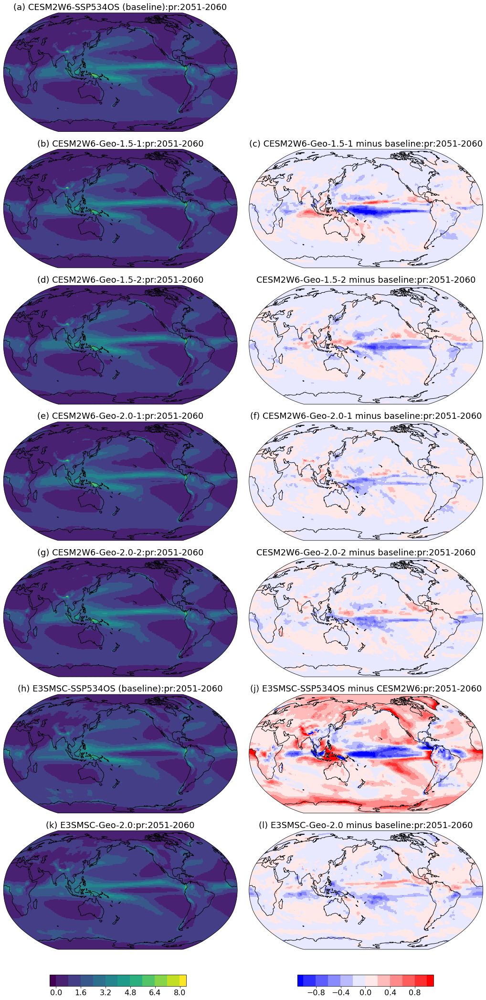

In [12]:
OLevs = np.linspace(0, 8, 11)
DLevs = np.linspace(-1, 1, 11)

plot_geomap('ssp534', 'Amon', 'sum', 'PRECT', 'pr', 1.0, 1.0e-3, True, 'pr', OLevs, DLevs, [2051, 2060], noLimit = False, Vname_E3SM='PRECC+PRECL+PRECSC+PRECSL', Sca_E3SM=1.0)

[0.  0.8 1.6 2.4 3.2 4.  4.8 5.6 6.4 7.2 8. ]
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.cam.h0.PRECT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.cam.h0.PRECT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.cam.h0.PRECT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.cam.h0.PRECT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/cesm2-waccm-esgf/ssp5

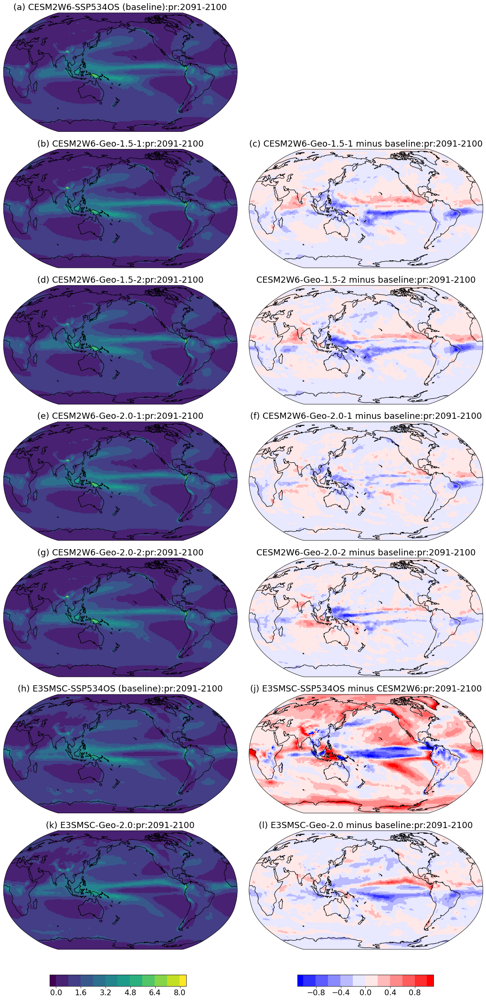

In [13]:
OLevs = np.linspace(0, 8, 11)
DLevs = np.linspace(-1, 1, 11)

plot_geomap('ssp534', 'Amon', 'sum', 'PRECT', 'pr', 1.0, 1.0e-3, True, 'pr', OLevs, DLevs, [2091, 2100], noLimit = False, Vname_E3SM='PRECC+PRECL+PRECSC+PRECSL', Sca_E3SM=1.0)

[   0.  400.  800. 1200. 1600. 2000. 2400. 2800. 3200. 3600. 4000.]
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.GPP.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.GPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.GPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.GPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_w

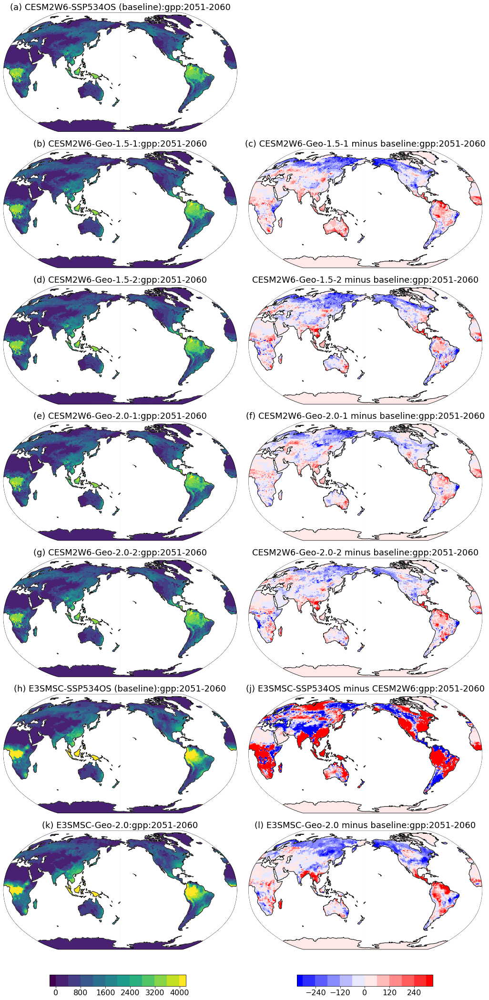

In [15]:
OLevs = np.linspace(0, 4000, 11)
DLevs = np.linspace(-300, 300, 11)

plot_geomap('ssp534', 'Lmon', 'sum', 'GPP', 'gpp', 1.0, 1000.0, True, 'gpp', OLevs, DLevs, [2051, 2060], noLimit = False, Vname_E3SM='GPP', Sca_E3SM=1.0, MskOcn=True)

[   0.  400.  800. 1200. 1600. 2000. 2400. 2800. 3200. 3600. 4000.]
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.GPP.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.GPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.GPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.GPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_w

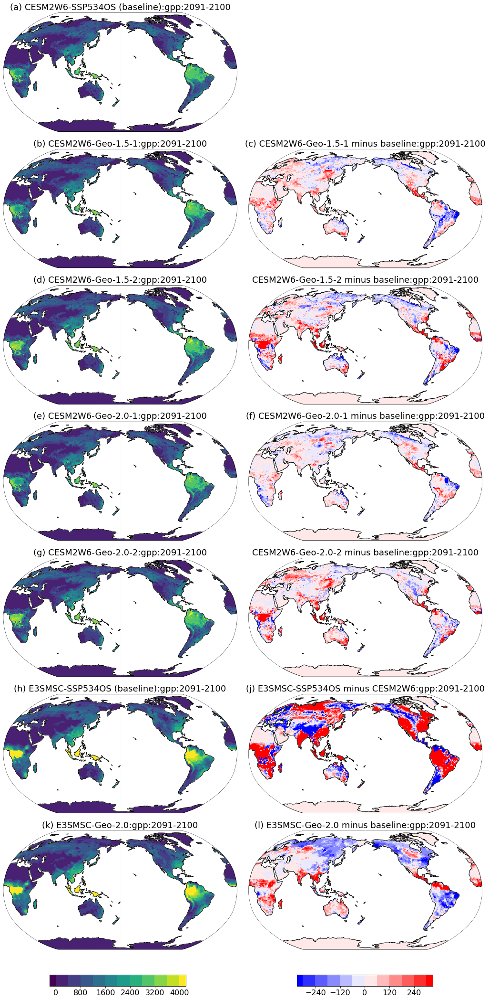

In [16]:
OLevs = np.linspace(0, 4000, 11)
DLevs = np.linspace(-300, 300, 11)

plot_geomap('ssp534', 'Lmon', 'sum', 'GPP', 'gpp', 1.0, 1000.0, True, 'gpp', OLevs, DLevs, [2091, 2100], noLimit = False, Vname_E3SM='GPP', Sca_E3SM=1.0, MskOcn=True)

[   0.  160.  320.  480.  640.  800.  960. 1120. 1280. 1440. 1600.]
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.NBP.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.NBP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.NBP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.NBP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_w

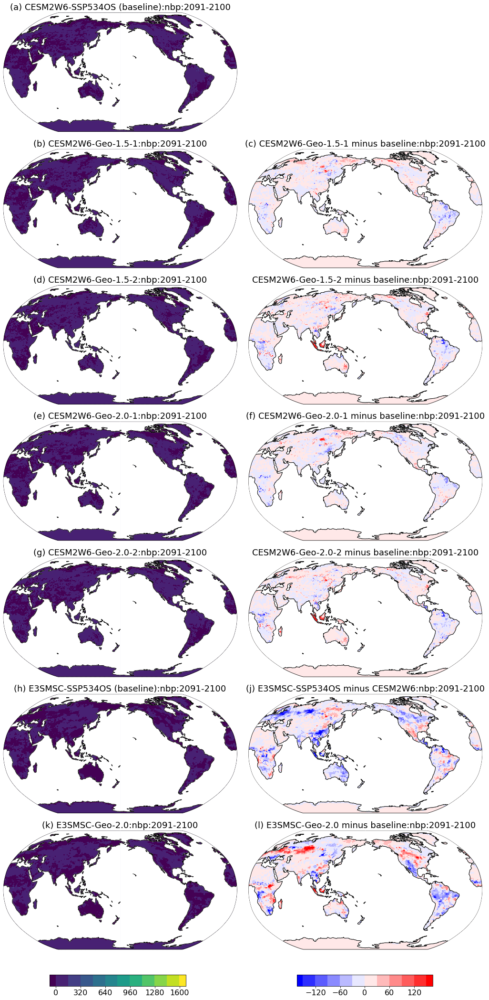

In [7]:
OLevs = np.linspace(0, 1600, 11)
DLevs = np.linspace(-150, 150, 11)

plot_geomap('ssp534', 'Lmon', 'sum', 'NBP', 'nbp', 1.0, 1000.0, True, 'nbp', OLevs, DLevs, [2091, 2100], noLimit = False, Vname_E3SM='NEE', Sca_E3SM=-1.0, MskOcn=True)

[   0.  160.  320.  480.  640.  800.  960. 1120. 1280. 1440. 1600.]
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.NPP.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.NPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.NPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.NPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_w

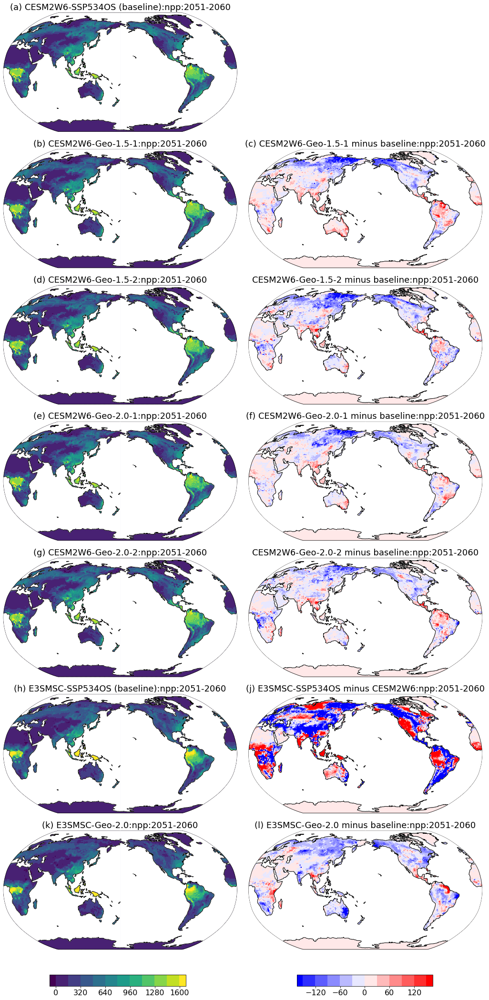

In [39]:
OLevs = np.linspace(0, 1600, 11)
DLevs = np.linspace(-150, 150, 11)

plot_geomap('ssp534', 'Lmon', 'sum', 'NPP', 'npp', 1.0, 1000.0, True, 'npp', OLevs, DLevs, YrRange=[2051,2060], noLimit = False, Vname_E3SM='NPP', Sca_E3SM=1.0, MskOcn=True)

[   0.  160.  320.  480.  640.  800.  960. 1120. 1280. 1440. 1600.]
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.NPP.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.NPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.NPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.NPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_w

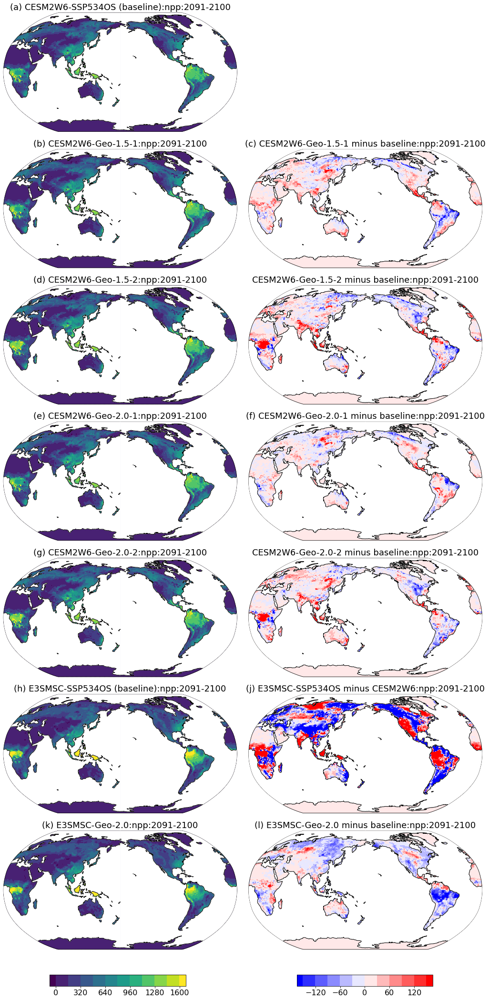

In [40]:
OLevs = np.linspace(0, 1600, 11)
DLevs = np.linspace(-150, 150, 11)

plot_geomap('ssp534', 'Lmon', 'sum', 'NPP', 'npp', 1.0, 1000.0, True, 'npp', OLevs, DLevs, YrRange=[2091,2100], noLimit = False, Vname_E3SM='NPP', Sca_E3SM=1.0, MskOcn=True)

[  0.  80. 160. 240. 320. 400. 480. 560. 640. 720. 800.]
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.AGNPP.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.AGNPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.AGNPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.AGNPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_wacc

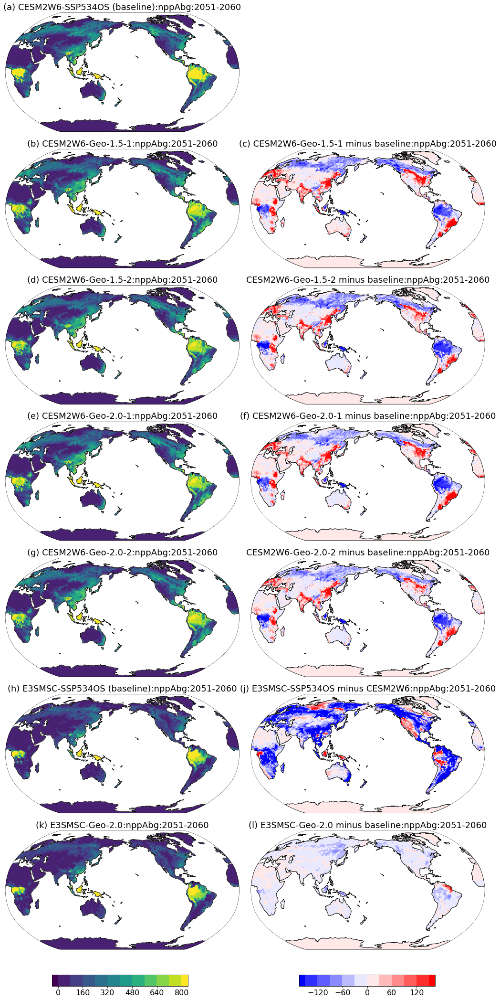

In [42]:
OLevs = np.linspace(0, 800, 11)
DLevs = np.linspace(-150, 150, 11)

plot_geomap('ssp534', 'Lmon', 'sum', 'AGNPP', 'nppLeaf+nppWood', 1.0, 1000.0, True, 'nppAbg', OLevs, DLevs, YrRange=[2051, 2060], noLimit = True, Vname_E3SM='AGNPP', Sca_E3SM=1.0, MskOcn=True)

[  0.  80. 160. 240. 320. 400. 480. 560. 640. 720. 800.]
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.AGNPP.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.AGNPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.AGNPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.AGNPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_wacc

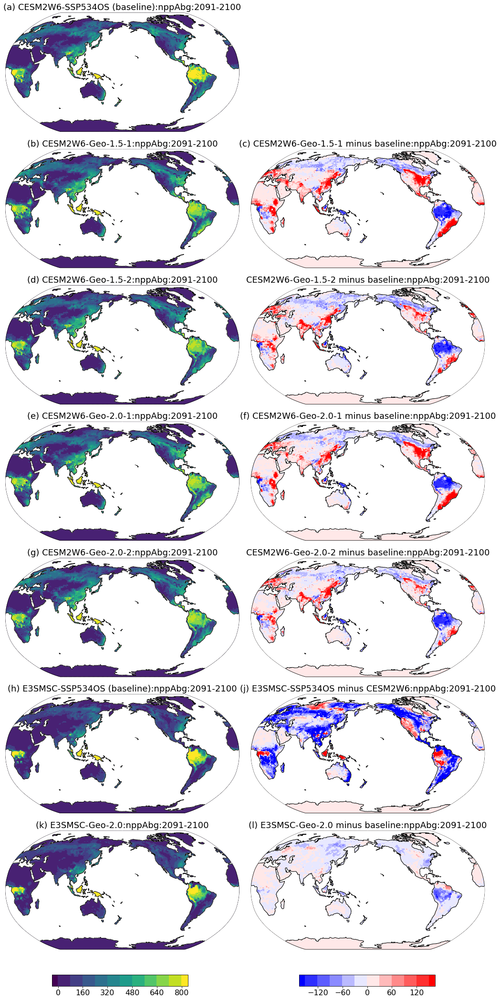

In [43]:
OLevs = np.linspace(0, 800, 11)
DLevs = np.linspace(-150, 150, 11)

plot_geomap('ssp534', 'Lmon', 'sum', 'AGNPP', 'nppLeaf+nppWood', 1.0, 1000.0, True, 'nppAbg', OLevs, DLevs, YrRange=[2091, 2100], noLimit = True, Vname_E3SM='AGNPP', Sca_E3SM=1.0, MskOcn=True)

[  0.  80. 160. 240. 320. 400. 480. 560. 640. 720. 800.]
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.BGNPP.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.BGNPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.BGNPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.BGNPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_wacc

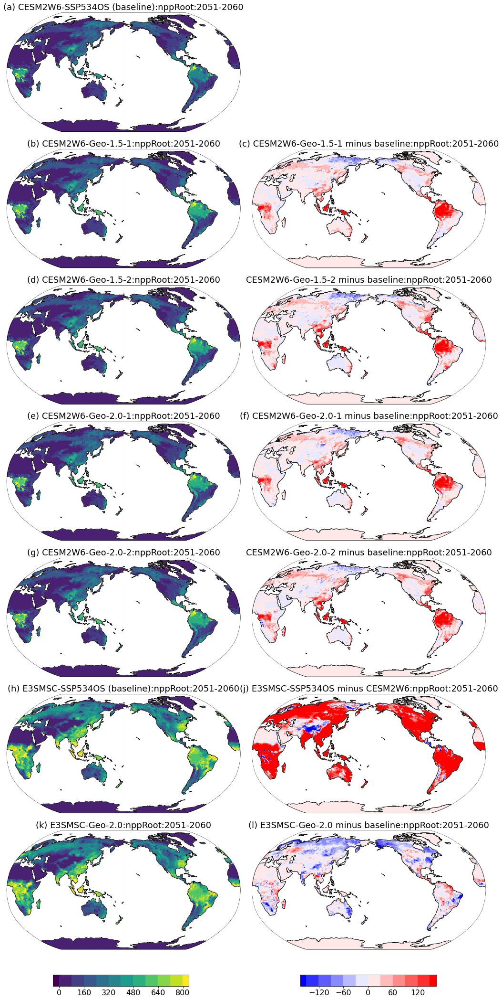

In [46]:
OLevs = np.linspace(0, 800, 11)
DLevs = np.linspace(-150, 150, 11)

plot_geomap('ssp534', 'Lmon', 'sum', 'BGNPP', 'nppRoot', 1.0, 1000.0, True, 'nppRoot', OLevs, DLevs, YrRange=[2051, 2060], noLimit = False, Vname_E3SM='NPP-AGNPP', Sca_E3SM=1.0, MskOcn=True)

[  0.  80. 160. 240. 320. 400. 480. 560. 640. 720. 800.]
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.BGNPP.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.BGNPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.BGNPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.BGNPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_wacc

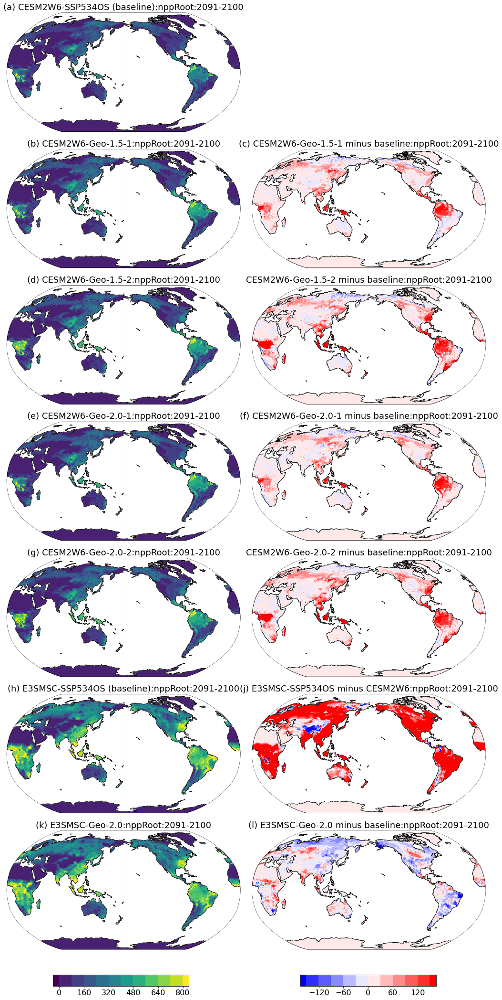

In [48]:
OLevs = np.linspace(0, 800, 11)
DLevs = np.linspace(-150, 150, 11)

plot_geomap('ssp534', 'Lmon', 'sum', 'BGNPP', 'nppRoot', 1.0, 1000.0, True, 'nppRoot', OLevs, DLevs, YrRange=[2091, 2100], noLimit = False, Vname_E3SM='NPP-AGNPP', Sca_E3SM=1.0, MskOcn=True)

[   0.  160.  320.  480.  640.  800.  960. 1120. 1280. 1440. 1600.]
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.AR.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.AR.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.AR.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.AR.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm

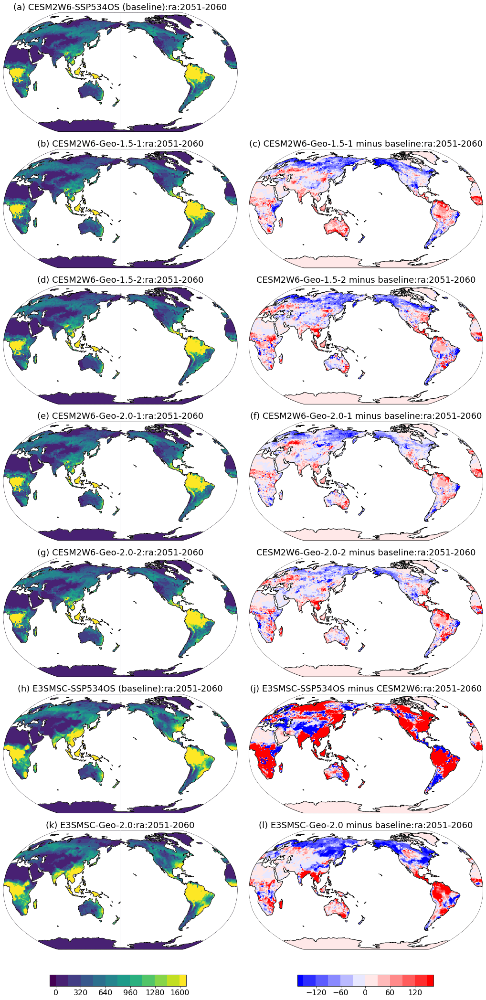

In [49]:
OLevs = np.linspace(0, 1600, 11)
DLevs = np.linspace(-150, 150, 11)

plot_geomap('ssp534', 'Lmon', 'sum', 'AR', 'ra', 1.0, 1000.0, True, 'ra', OLevs, DLevs, YrRange=[2051, 2060], noLimit = False, Vname_E3SM='AR', Sca_E3SM=1.0, MskOcn=True)

[   0.  160.  320.  480.  640.  800.  960. 1120. 1280. 1440. 1600.]
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.AR.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.AR.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.AR.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.AR.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm

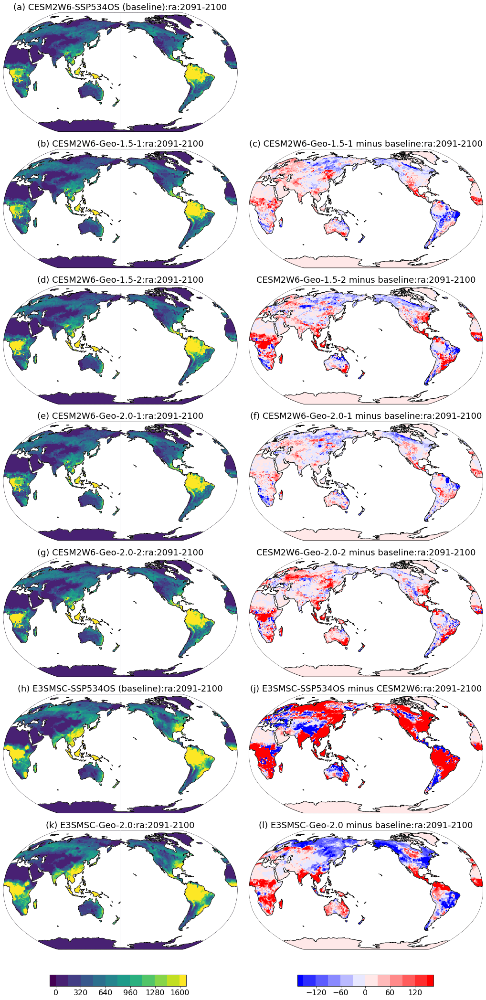

In [50]:
OLevs = np.linspace(0, 1600, 11)
DLevs = np.linspace(-150, 150, 11)

plot_geomap('ssp534', 'Lmon', 'sum', 'AR', 'ra', 1.0, 1000.0, True, 'ra', OLevs, DLevs, YrRange=[2091, 2100], noLimit = False, Vname_E3SM='AR', Sca_E3SM=1.0, MskOcn=True)

[   0.  160.  320.  480.  640.  800.  960. 1120. 1280. 1440. 1600.]
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.HR.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.HR.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.HR.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.HR.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm

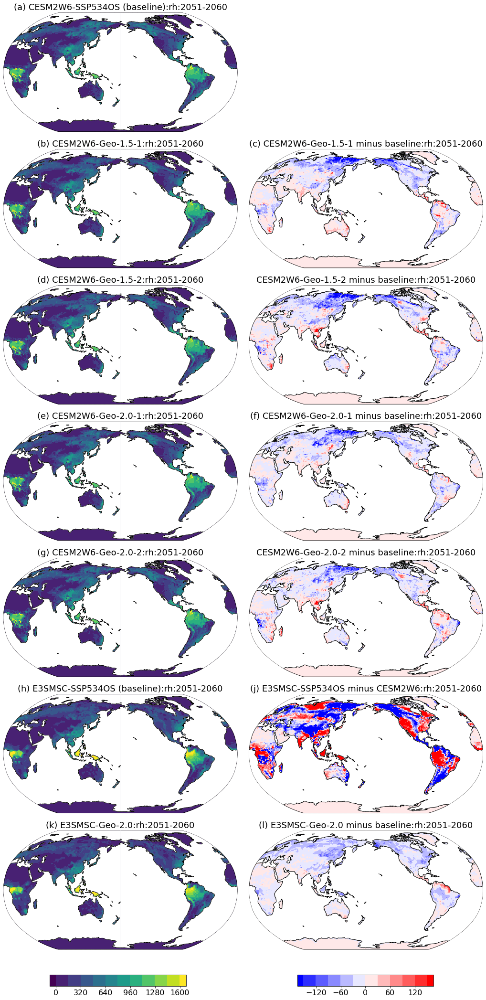

In [51]:
OLevs = np.linspace(0, 1600, 11)
DLevs = np.linspace(-150, 150, 11)

plot_geomap('ssp534', 'Lmon', 'sum', 'HR', 'rh', 1.0, 1000.0, True, 'rh', OLevs, DLevs, YrRange=[2051, 2060], noLimit = False, Vname_E3SM='HR', Sca_E3SM=1.0, MskOcn=True)

[   0.  160.  320.  480.  640.  800.  960. 1120. 1280. 1440. 1600.]
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.HR.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.HR.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.HR.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.HR.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm

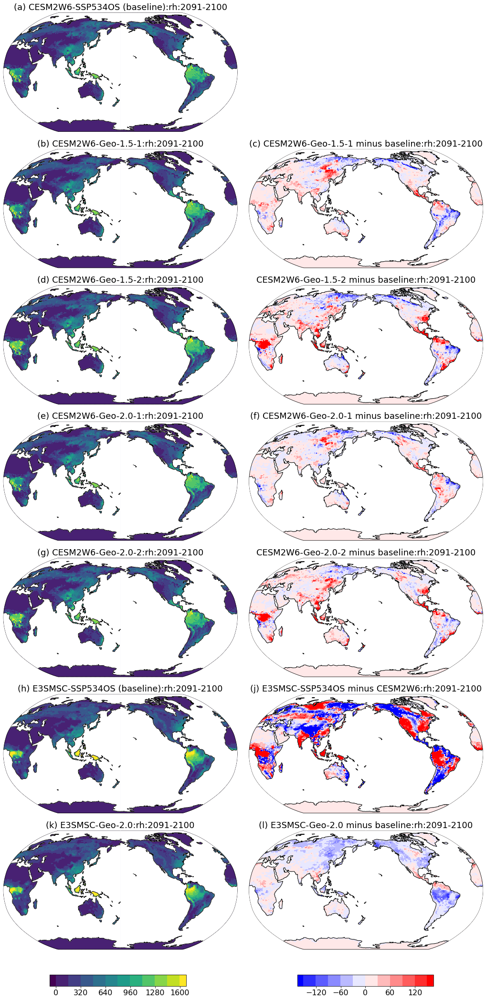

In [52]:
OLevs = np.linspace(0, 1600, 11)
DLevs = np.linspace(-150, 150, 11)

plot_geomap('ssp534', 'Lmon', 'sum', 'HR', 'rh', 1.0, 1000.0, True, 'rh', OLevs, DLevs, YrRange=[2091, 2100], noLimit = False, Vname_E3SM='HR', Sca_E3SM=1.0, MskOcn=True)

[0.  0.8 1.6 2.4 3.2 4.  4.8 5.6 6.4 7.2 8. ]
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.TLAI.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.TLAI.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.TLAI.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.TLAI.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/cesm2-waccm-e

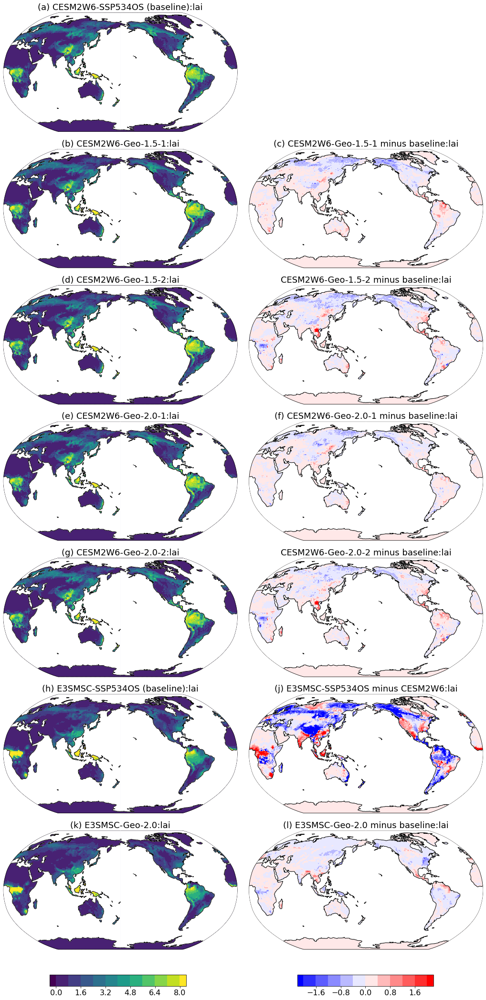

In [15]:
OLevs = np.linspace(0, 8, 11)
DLevs = np.linspace(-2, 2, 11)

plot_geomap('ssp534', 'Lmon', 'avg', 'TLAI', 'lai', 1.0, 1.0, True, 'lai', OLevs, DLevs, noLimit = False, Vname_E3SM='TLAI', Sca_E3SM=1.0, MskOcn=True)

[0.  0.8 1.6 2.4 3.2 4.  4.8 5.6 6.4 7.2 8. ]
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.TLAI.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.TLAI.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.TLAI.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.TLAI.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/cesm2-waccm-e

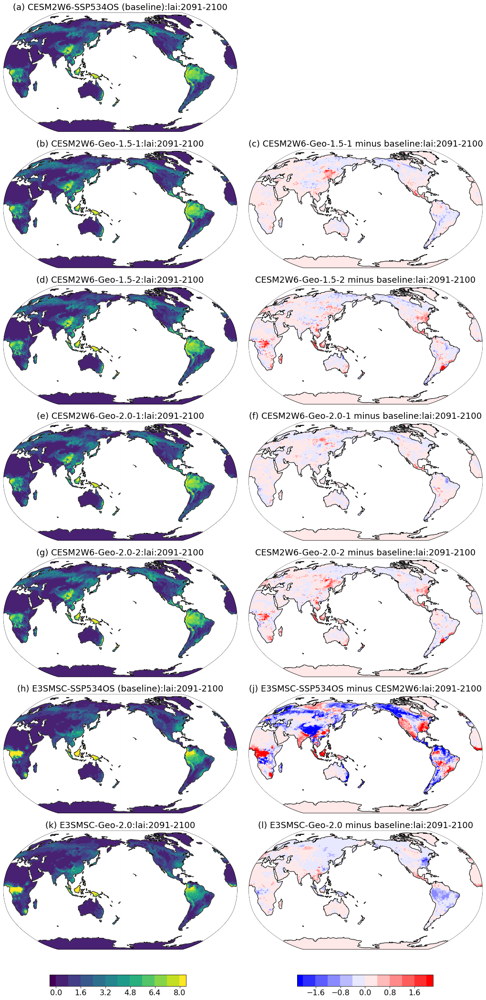

In [53]:
OLevs = np.linspace(0, 8, 11)
DLevs = np.linspace(-2, 2, 11)

plot_geomap('ssp534', 'Lmon', 'avg', 'TLAI', 'lai', 1.0, 1.0, True, 'lai', OLevs, DLevs, YrRange=[2091,2100], noLimit = False, Vname_E3SM='TLAI', Sca_E3SM=1.0, MskOcn=True)

[ 1.   1.9  2.8  3.7  4.6  5.5  6.4  7.3  8.2  9.1 10. ]
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.TOTVEGC.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.TOTVEGC.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.TOTVEGC.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.TOTVEGC.*.nc
/gpfs/alpine/cli137/world-shared/mxu/ce

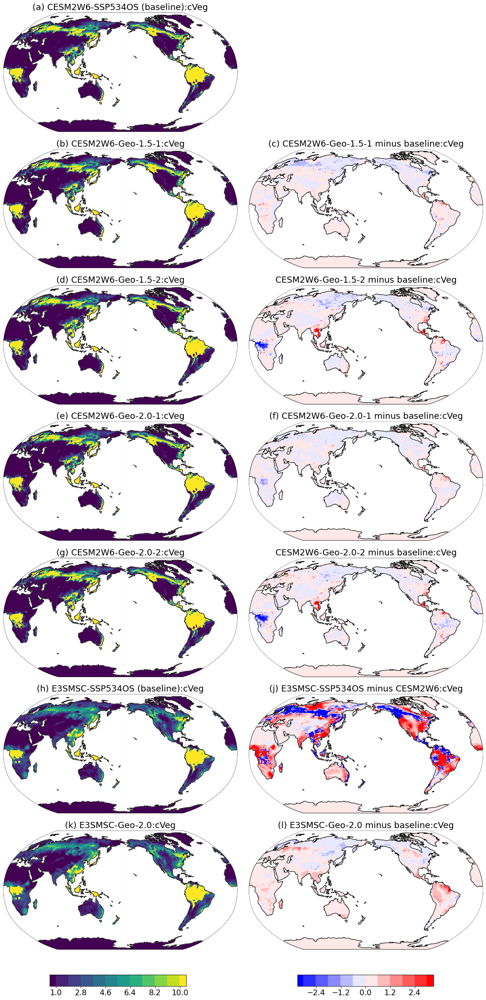

In [18]:
OLevs = np.linspace(1, 10, 11)
DLevs = np.linspace(-3, 3, 11)

plot_geomap('ssp534', 'Lmon', 'avg', 'TOTVEGC', 'cVeg', 1.0e-3, 1.0, True, 'cVeg', OLevs, DLevs, noLimit = False, Vname_E3SM='TOTVEGC', Sca_E3SM=1.0e-3, MskOcn=True)

[ 1.   1.9  2.8  3.7  4.6  5.5  6.4  7.3  8.2  9.1 10. ]
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.TOTVEGC.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.TOTVEGC.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.TOTVEGC.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.TOTVEGC.*.nc
/gpfs/alpine/cli137/world-shared/mxu/ce

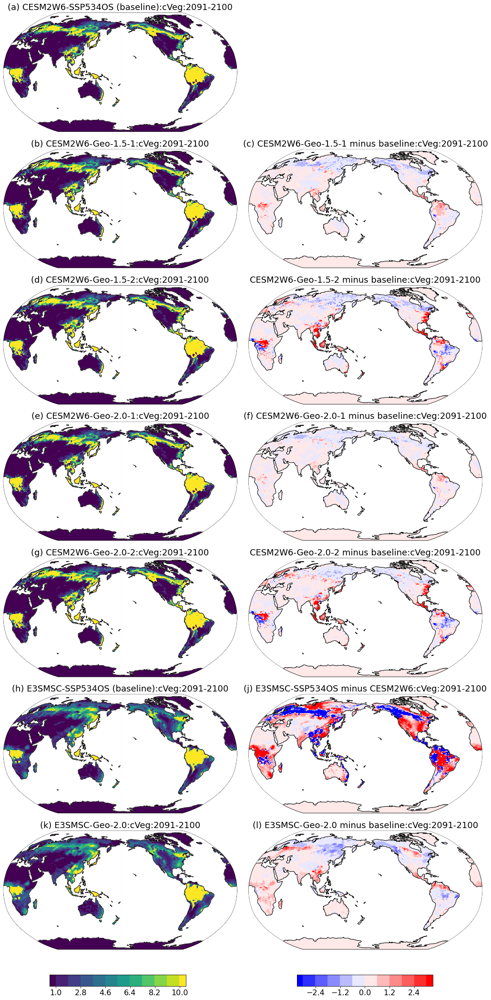

In [45]:
OLevs = np.linspace(1, 10, 11)
DLevs = np.linspace(-3, 3, 11)

plot_geomap('ssp534', 'Lmon', 'avg', 'TOTVEGC', 'cVeg', 1.0e-3, 1.0, True, 'cVeg', OLevs, DLevs, YrRange=[2091, 2100], noLimit = False, Vname_E3SM='TOTVEGC', Sca_E3SM=1.0e-3, MskOcn=True)

[240.  245.3 250.6 255.9 261.2 266.5 271.8 277.1 282.4 287.7 293. ]
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.cam.h0.TREFHT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.cam.h0.TREFHT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.cam.h0.TREFHT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.cam.h0.TREFHT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_w

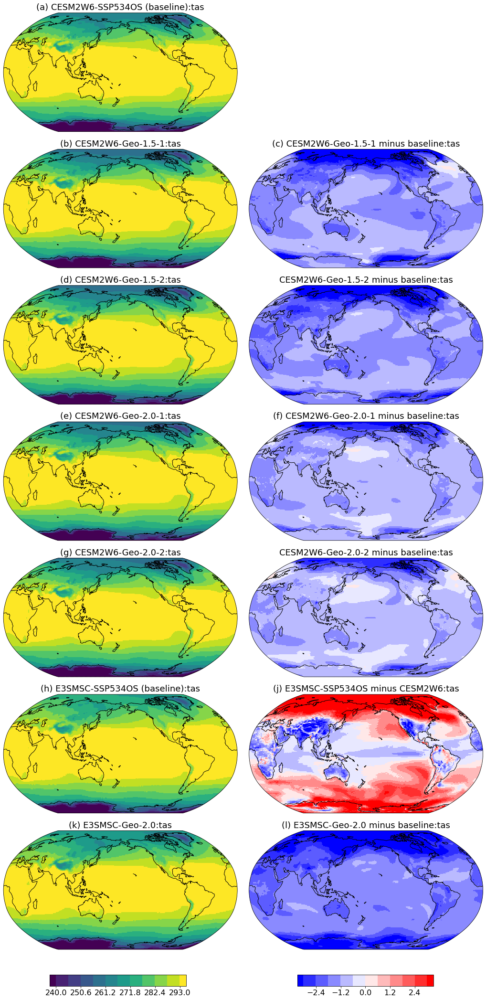

In [9]:
OLevs = np.linspace(240, 293, 11)
DLevs = np.linspace(-3, 3, 11)
plot_geomap('ssp534', 'Amon', 'avg', 'TREFHT', 'tas', 1.0, 1.0, True, 'tas', OLevs, DLevs, noLimit = False, Vname_E3SM='TREFHT', Sca_E3SM=1.0)

[240.  245.3 250.6 255.9 261.2 266.5 271.8 277.1 282.4 287.7 293. ]
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.cam.h0.TREFHT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.cam.h0.TREFHT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.cam.h0.TREFHT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.cam.h0.TREFHT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_w

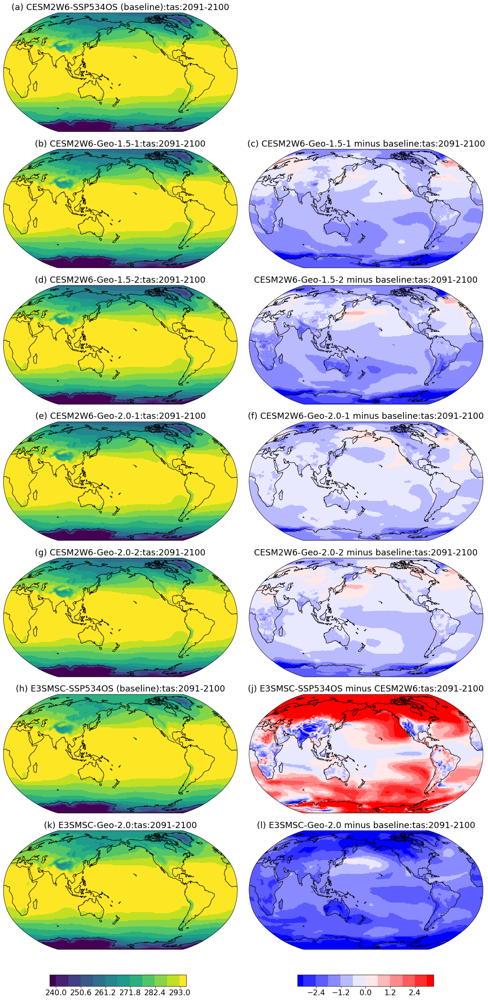

In [54]:
OLevs = np.linspace(240, 293, 11)
DLevs = np.linspace(-3, 3, 11)
plot_geomap('ssp534', 'Amon', 'avg', 'TREFHT', 'tas', 1.0, 1.0, True, 'tas', OLevs, DLevs, YrRange=[2091, 2100], noLimit = False, Vname_E3SM='TREFHT', Sca_E3SM=1.0)

[ 60.  78.  96. 114. 132. 150. 168. 186. 204. 222. 240.]
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.cam.h0.FSDS.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.cam.h0.FSDS.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.cam.h0.FSDS.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.cam.h0.FSDS.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/cesm2-waccm-es

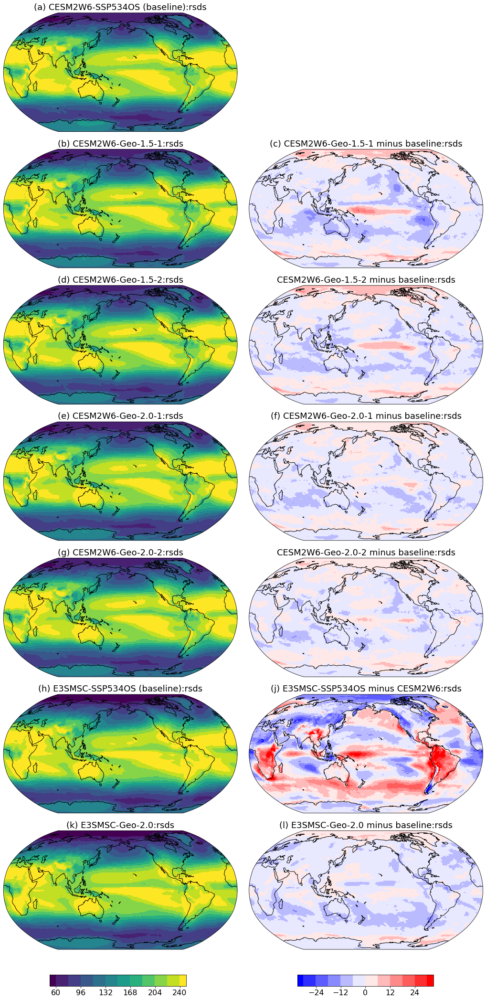

In [29]:
OLevs = np.linspace(60, 240, 11)
DLevs = np.linspace(-30, 30, 11)
plot_geomap('ssp534', 'Amon', 'avg', 'FSDS', 'rsds', 1.0, 1.0, True, 'rsds', OLevs, DLevs, noLimit = False, Vname_E3SM='FSDS', Sca_E3SM=1.0)

[100. 120. 140. 160. 180. 200. 220. 240. 260. 280. 300.]
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.cam.h0.FLDS.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.cam.h0.FLDS.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.cam.h0.FLDS.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.cam.h0.FLDS.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/cesm2-waccm-es

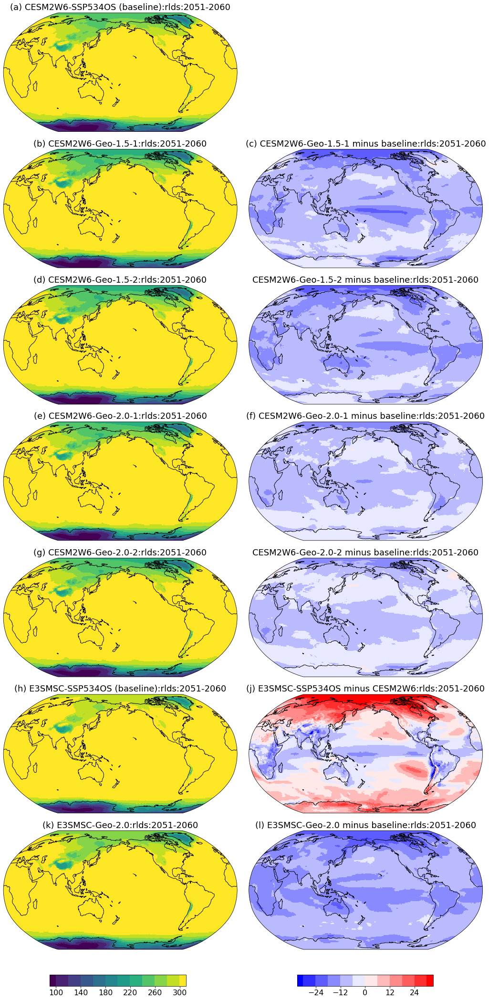

In [38]:
OLevs = np.linspace(100, 300, 11)
DLevs = np.linspace(-30, 30, 11)
plot_geomap('ssp534', 'Amon', 'avg', 'FLDS', 'rlds', 1.0, 1.0, True, 'rlds', OLevs, DLevs, YrRange=[2051, 2060], noLimit = False, Vname_E3SM='FLDS', Sca_E3SM=1.0)

[ 60.  66.  72.  78.  84.  90.  96. 102. 108. 114. 120.]
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.cam.h0.FSUTOA.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.cam.h0.FSUTOA.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.cam.h0.FSUTOA.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.cam.h0.FSUTOA.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/cesm2-

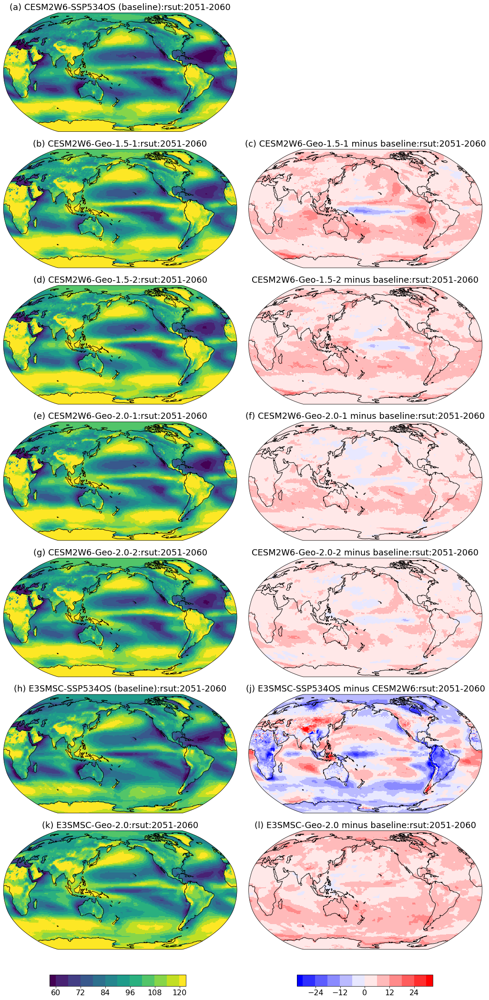

In [37]:
OLevs = np.linspace(60, 120, 11)
DLevs = np.linspace(-30, 30, 11)
plot_geomap('ssp534', 'Amon', 'avg', 'FSUTOA', 'rsut', 1.0, 1.0, True, 'rsut', OLevs, DLevs, YrRange=[2051, 2060], noLimit = False, Vname_E3SM='FSUTOA', Sca_E3SM=1.0)

[100. 120. 140. 160. 180. 200. 220. 240. 260. 280. 300.]
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.cam.h0.FSNT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.cam.h0.FSNT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.cam.h0.FSNT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.cam.h0.FSNT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534

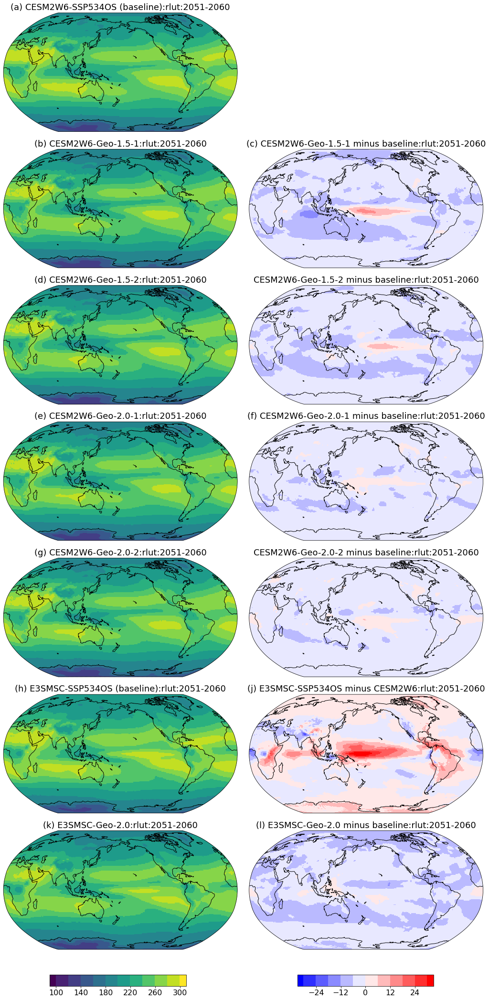

In [36]:
OLevs = np.linspace(100, 300, 11)
DLevs = np.linspace(-30, 30, 11)
plot_geomap('ssp534', 'Amon', 'avg', 'FSNTOA-FSNT+FLNT', 'rlut', 1.0, 1.0, True, 'rlut', OLevs, DLevs, noLimit = True, YrRange=[2051,2060], Vname_E3SM='FSNTOA-FSNT+FLNT', Sca_E3SM=1.0)

/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.AGNPP.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.AGNPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.AGNPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.AGNPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.fe

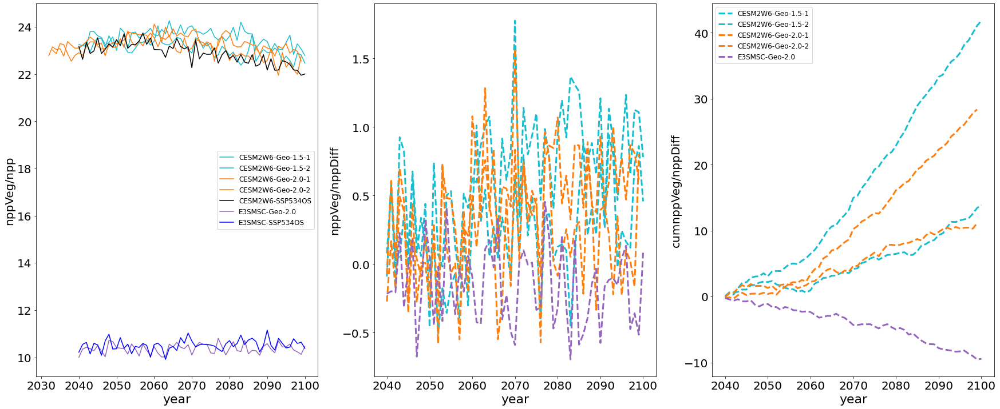

In [15]:
plot_ts('ssp534', 'Lmon', 'avg', 'AGNPP/NPP', '(nppWood+nppLeaf)/npp', 100.0, 100., True, 'nppVeg/npp', noLimit = False, Vname_E3SM='AGNPP/NPP', Sca_E3SM=100.0)

/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.cam.h0.PRECT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.cam.h0.PRECT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.cam.h0.PRECT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.cam.h0.PRECT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/cesm2-waccm-esgf/ssp534-over/r1i1p1f1/Amon/pr/gn/v20190815/*.nc
/gp

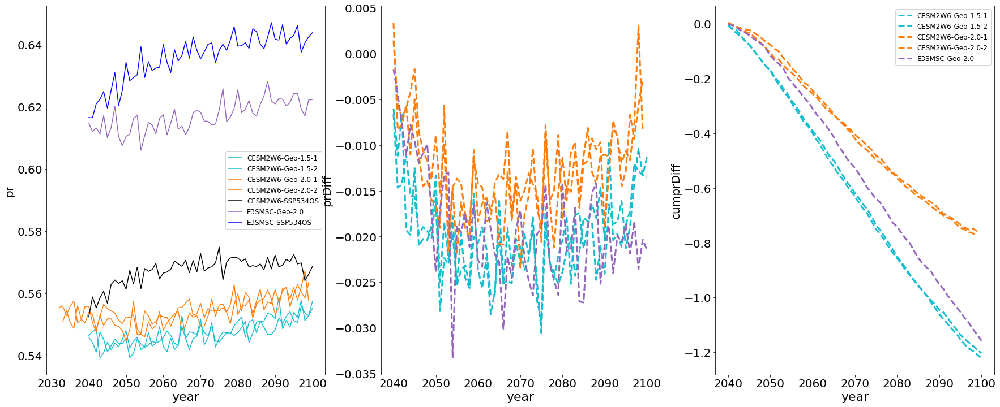

In [16]:
plot_ts('ssp534', 'Amon', 'sum', 'PRECT', 'pr', 1.0, 1.0e-3, True, 'pr', noLimit = False, Vname_E3SM='PRECC+PRECL+PRECSC+PRECSL', Sca_E3SM=1.0)

/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.TLAI.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.TLAI.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.TLAI.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.TLAI.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/cesm2-waccm-esgf/ssp534-over/r1i1p1f1/Lmon/lai/gn/v20190815

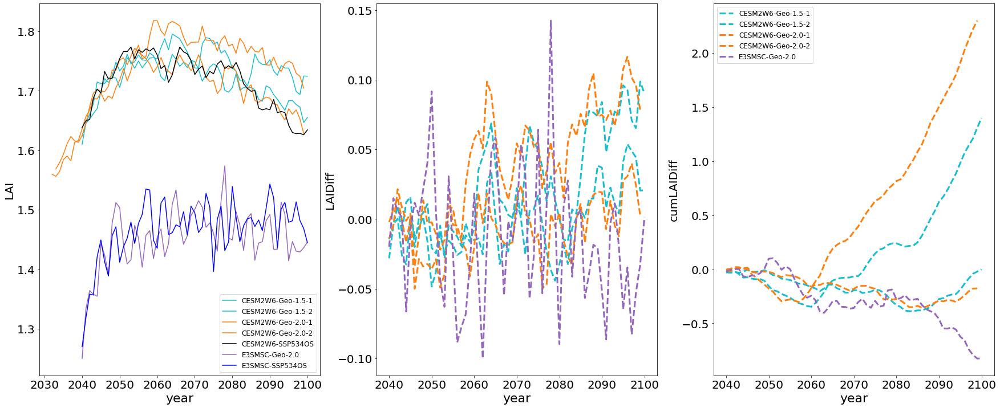

In [17]:
plot_ts('ssp534', 'Lmon', 'avg', 'TLAI', 'lai', 1.0, 1.0, True, 'LAI', noLimit=True, Vname_E3SM='TLAI', Sca_E3SM=1.0)

/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.cam.h0.TREFHT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.cam.h0.TREFHT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.cam.h0.TREFHT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.cam.h0.TREFHT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/cesm2-waccm-esgf/ssp534-over/r1i1p1f1/Amon/tas/gn/v20190815/*.n

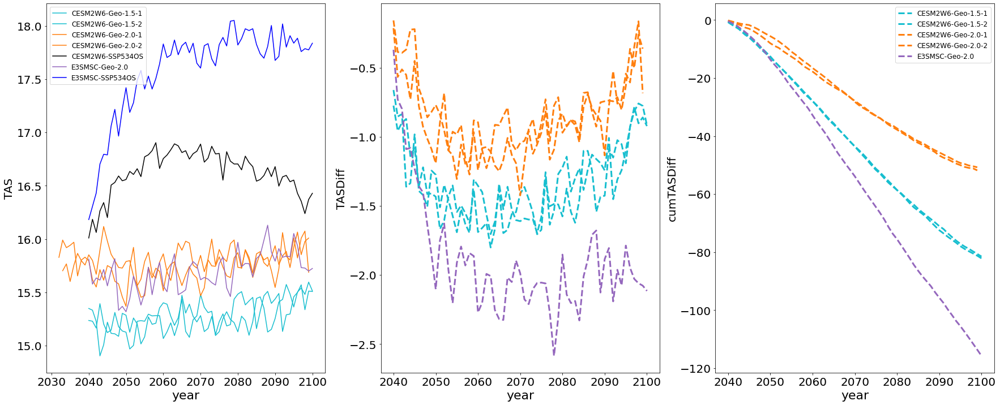

In [18]:
plot_ts('ssp534', 'Amon', 'avg', 'TREFHT', 'tas', 1.0, 1.0, True, 'TAS', Vname_E3SM='TREFHT', Sca_E3SM=1.0, Fct_NCAR=-273.15, Fct_ESGF=-273.15, Fct_E3SM=-273.15)

/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.TSA.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.TSA.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.TSA.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.TSA.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/cesm2-waccm-esgf/ssp534-over/r1i1p1f1/Amon/tas/gn/v20190815/*.n

No handles with labels found to put in legend.


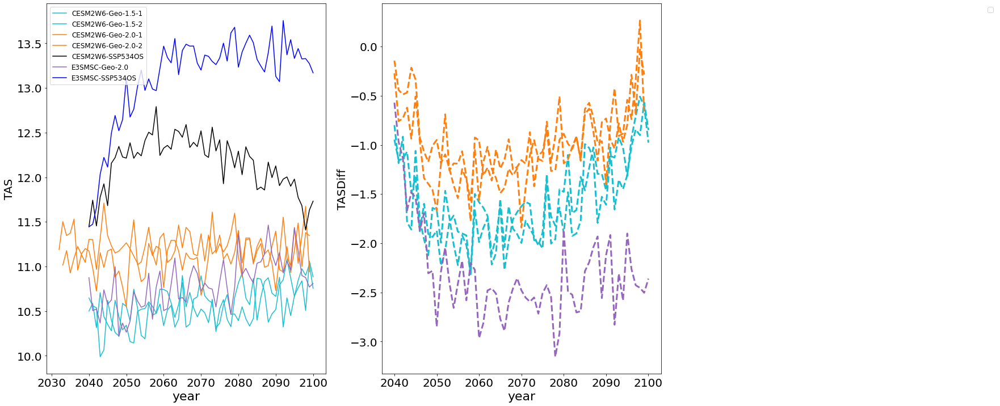

In [19]:
plot_ts('ssp534', 'Lmon', 'avg', 'TSA', 'tas', 1.0, 1.0, False, 'TAS', Vname_E3SM='TSA', Sca_E3SM=1.0, Fct_NCAR=-273.15, Fct_ESGF=-273.15, Fct_E3SM=-273.15)

/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.GPP.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.GPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.GPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.GPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/cesm2-waccm-esgf/ssp534-over/r1i1p1f1/Lmon/gpp/gn/v20190815/*.n

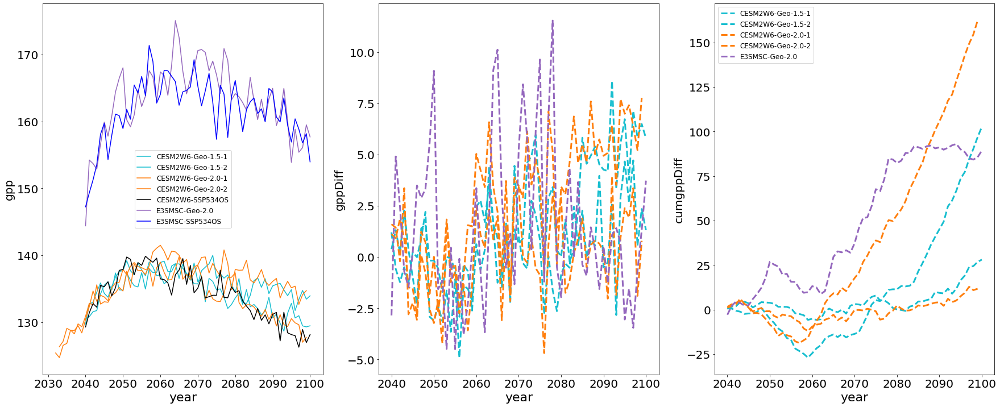

In [20]:
plot_ts('ssp534', 'Lmon', 'sum', 'GPP', 'gpp', 1.0, 1000.0, True, 'gpp', noLimit=True, Vname_E3SM='GPP', Sca_E3SM=1.0)

/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.NPP.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.NPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.NPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.NPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/cesm2-waccm-esgf/ssp534-over/r1i1p1f1/Lmon/npp/gn/v20190815/*.n

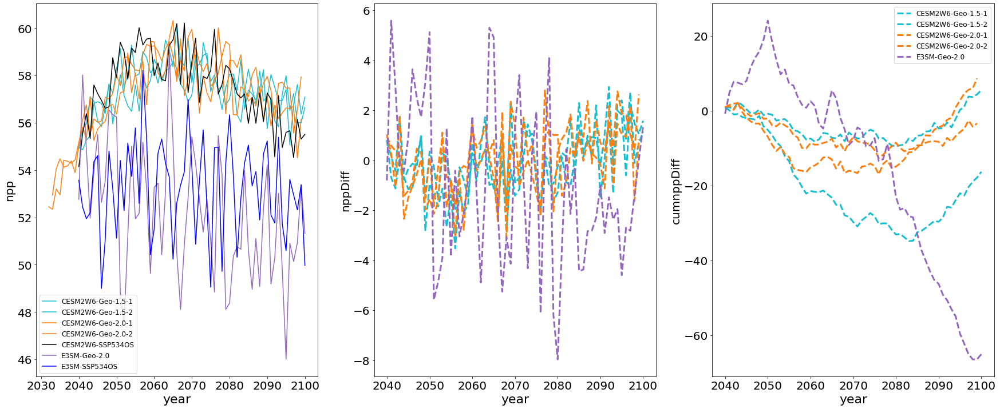

In [69]:
plot_ts('ssp534', 'Lmon', 'sum', 'NPP', 'npp', 1.0, 1000.0, True, 'npp', noLimit=True, Vname_E3SM='NPP', Sca_E3SM=1.0)

/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.NBP.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.NBP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.NBP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.NBP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/cesm2-waccm-esgf/ssp534-over/r1i1p1f1/Lmon/nbp/gn/v20190815/*.n

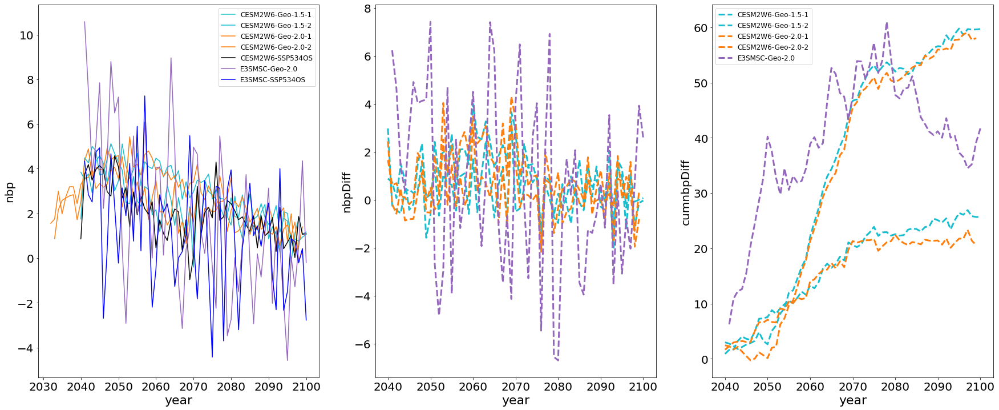

In [61]:
plot_ts('ssp534', 'Lmon', 'sum', 'NBP', 'nbp', 1.0, 1000.0, True, 'nbp', noLimit=True, Vname_E3SM='NEE', Sca_E3SM=-1.0)

* the extreme low NBP in the first year of E3SM SSP534OS may due to the inconsistency WACCM stratospheric aerosol loading and ozone 

/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.HR.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.HR.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.HR.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.HR.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/cesm2-waccm-esgf/ssp534-over/r1i1p1f1/Lmon/rh/gn/v20190815/*.nc
/gp

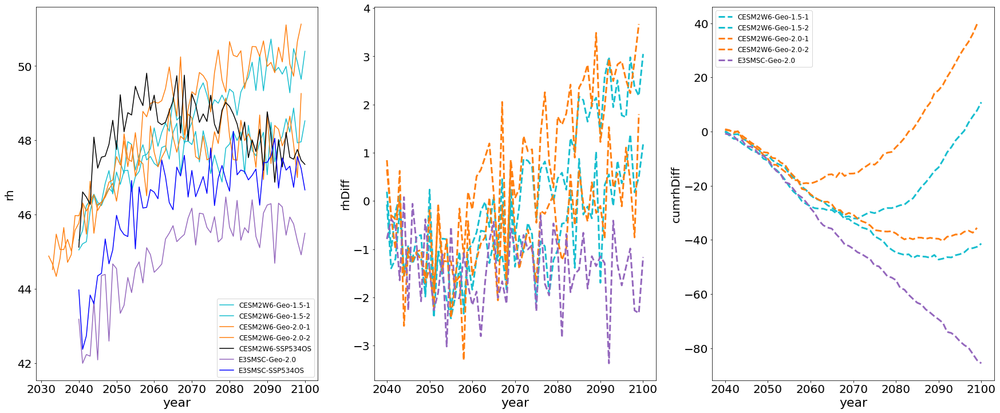

In [22]:
plot_ts('ssp534', 'Lmon', 'sum', 'HR', 'rh', 1.0, 1000.0, True, 'rh', noLimit=True, Vname_E3SM='HR', Sca_E3SM=1.0)

/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.AR.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.AR.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.AR.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.AR.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/cesm2-waccm-esgf/ssp534-over/r1i1p1f1/Lmon/ra/gn/v20190815/*.nc
/gp

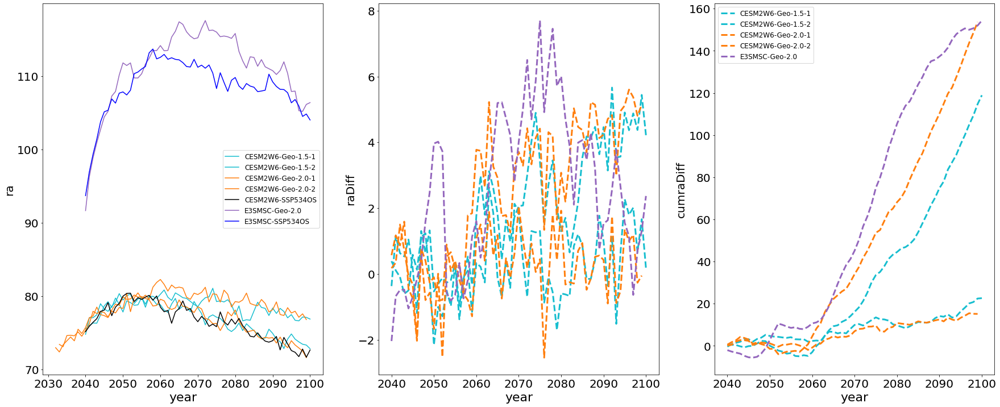

In [23]:
plot_ts('ssp534', 'Lmon', 'sum', 'AR', 'ra', 1.0, 1000.0, True, 'ra', noLimit=True, Vname_E3SM='AR', Sca_E3SM=1.0)

/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.COL_FIRE_CLOSS.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.COL_FIRE_CLOSS.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.COL_FIRE_CLOSS.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.COL_FIRE_CLOSS.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/cesm2-waccm-esgf/ss

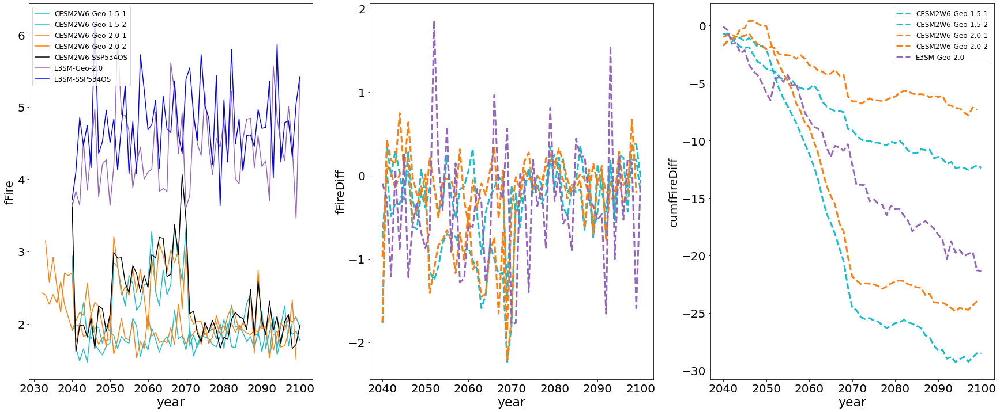

In [7]:
plot_ts('ssp534', 'Lmon', 'sum', 'COL_FIRE_CLOSS', 'fFire', 1.0, 1000.0, True, 'fFire', noLimit=True, Vname_E3SM='COL_FIRE_CLOSS', Sca_E3SM=1.0)

/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.cam.h0.FSDS.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.cam.h0.FSDS.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.cam.h0.FSDS.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.cam.h0.FSDS.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/cesm2-waccm-esgf/ssp534-over/r1i1p1f1/Amon/rsds/gn/v20190815/*.nc
/gpfs

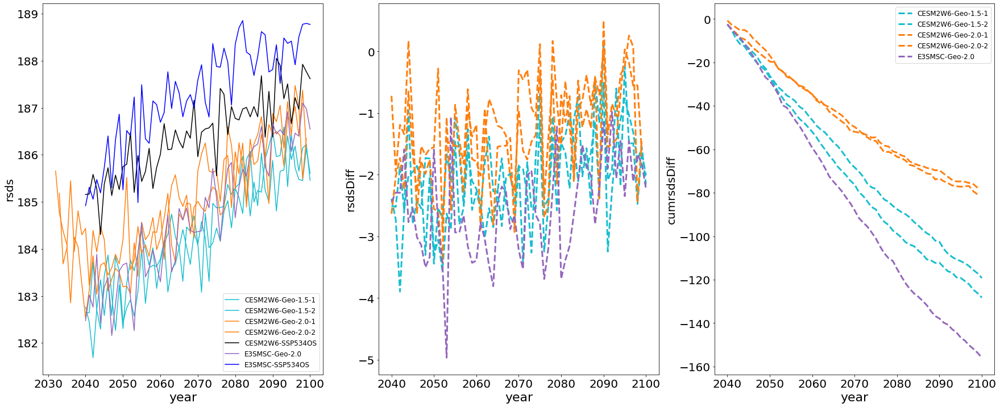

In [24]:
plot_ts('ssp534', 'Amon', 'avg', 'FSDS', 'rsds', 1.0, 1.0, True, 'rsds', noLimit=True, Vname_E3SM='FSDS', Sca_E3SM=1.0)

/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.cam.h0.FLDS.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.cam.h0.FLDS.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.cam.h0.FLDS.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.cam.h0.FLDS.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/cesm2-waccm-esgf/ssp534-over/r1i1p1f1/Amon/rlds/gn/v20190815/*.nc
/gpfs

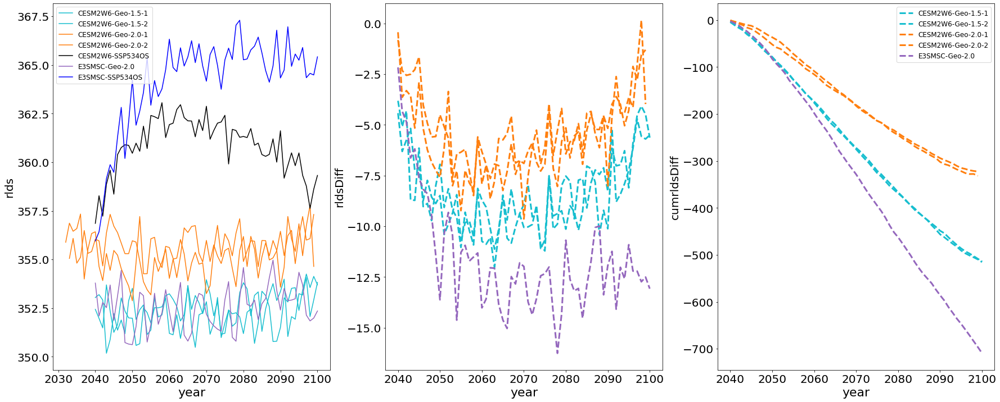

In [25]:
plot_ts('ssp534', 'Amon', 'avg', 'FLDS', 'rlds', 1.0, 1.0, True, 'rlds', noLimit=True, Vname_E3SM='FLDS', Sca_E3SM=1.0)

/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.SOILWATER_10CM.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.SOILWATER_10CM.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.SOILWATER_10CM.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.SOILWATER_10CM.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/cesm2-waccm-esgf/ss

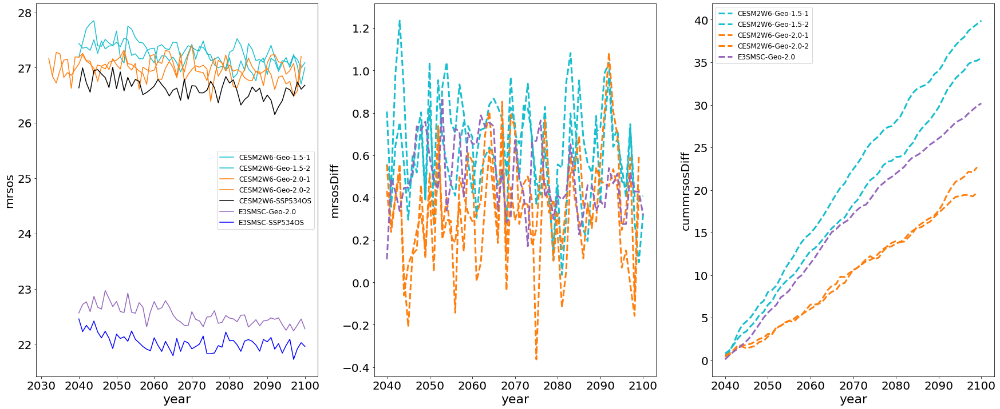

In [35]:
plot_ts('ssp534', 'Lmon', 'avg', 'SOILWATER_10CM', 'mrsos', 1.0, 1.0, True, 'mrsos', noLimit=True, Vname_E3SM='SOILWATER_10CM', Sca_E3SM=1.0)

In [ ]:
plot_ts('ssp534', 'Lmon', 'avg', 'BGNPP/NPP', 'nppRoot/npp', 100.0, 100., False, 'nppRoot/npp')

In [ ]:
plot_ts('ssp534', 'Lmon', 'avg', 'BGNPP/NPP', 'nppRoot/npp', 100.0, 100., False, 'nppRoot/npp')

In [ ]:
dsGPP15 = open_files('ncar', 'SSP534-PK', 'Lmon', GeoPK15_case, 'GPP')
dsGPP20 = open_files('ncar', 'SSP534-PK', 'Lmon', GeoPK20_case, 'GPP')
dsGPP_base = open_files('esgf', 'ssp534-over', 'Lmon', '', 'gpp')

GPP15_TsGBL = gm_by_area_wght(dsGPP15, 'GPP', 'sum', True, None, None)
GPP20_TsGBL = gm_by_area_wght(dsGPP20, 'GPP', 'sum', True, None, None)
GPP_base_TsGBL = gm_by_area_wght(dsGPP_base, 'gpp', 'sum', False, dsGPP.area, dsGPP.landfrac, TimeShift=False) * 1000  # from kg to g
plot_ts_diff([GPP15_TsGBL, GPP20_TsGBL, GPP_base_TsGBL], True, ['1.5', '2.0', 'SSP5-34OS'])

In [ ]:
dsTSA15 = open_files('ncar', 'SSP534-PK', 'Lmon', GeoPK15_case, 'TSA')
dsTSA20 = open_files('ncar', 'SSP534-PK', 'Lmon', GeoPK20_case, 'TSA')
dsTSA_base = open_files('esgf', 'ssp534-over', 'Amon', '', 'tas')

TSA15_TsGBL = gm_by_area_wght(dsTSA15, 'TSA', 'avg', True, None, None)
TSA20_TsGBL = gm_by_area_wght(dsTSA20, 'TSA', 'avg', True, None, None)

TSA_base_TsGBL = gm_by_area_wght(dsTSA_base, 'tas', 'avg', False, dsTSA15.area, dsTSA15.landfrac, TimeShift=False)
plot_ts_diff([TSA15_TsGBL, TSA20_TsGBL, TSA_base_TsGBL], False, ['1.5', '2.0', 'SSP5-34OS'])

/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.NPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/cesm2-waccm-esgf/ssp534-over/r1i1p1f1/Lmon/npp/gn/*/*.nc


/autofs/nccs-svm1_proj/cli143/mxu/my-venv-jupyter-py37/lib/python3.7/site-packages/xarray/conventions.py:520: SerializationWarning: variable 'npp' has multiple fill values {1e+20, 1e+20}, decoding all values to NaN.
  decode_timedelta=decode_timedelta,


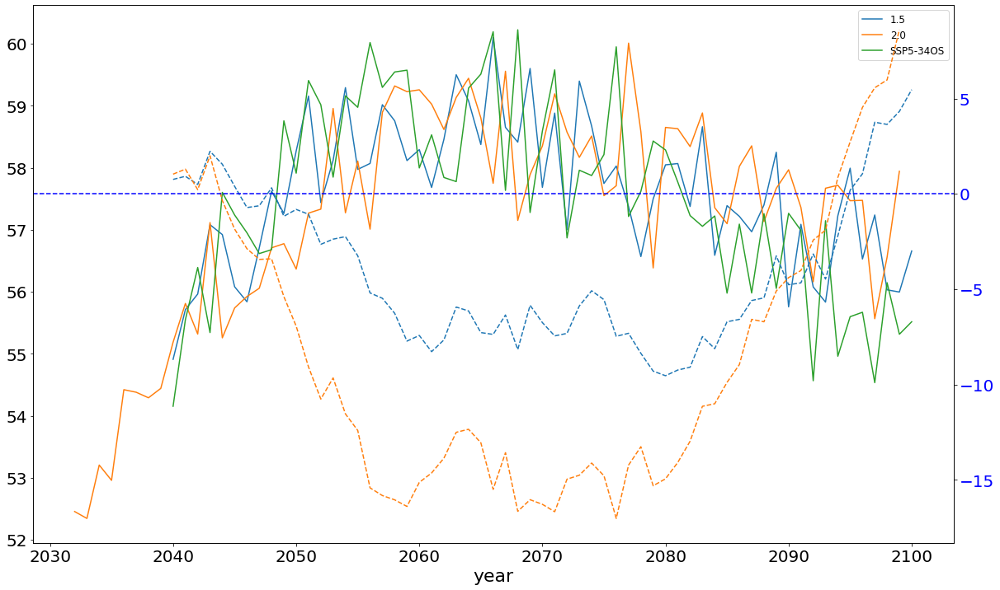

In [219]:
dsNPP15 = open_files('ncar', 'SSP534-PK', 'Lmon', GeoPK15_case, 'NPP')
dsNPP20 = open_files('ncar', 'SSP534-PK', 'Lmon', GeoPK20_case, 'NPP')
dsNPP_base = open_files('esgf', 'ssp534-over', 'Lmon', '', 'npp')

NPP15_TsGBL = gm_by_area_wght(dsNPP15, 'NPP', 'sum', True, None, None)
NPP20_TsGBL = gm_by_area_wght(dsNPP20, 'NPP', 'sum', True, None, None)
NPP_base_TsGBL = gm_by_area_wght(dsNPP_base, 'npp', 'sum', False, dsNPP15.area, dsNPP15.landfrac, TimeShift=False) * 1000  # from kg to g
plot_ts_diff([NPP15_TsGBL, NPP20_TsGBL, NPP_base_TsGBL], True, ['1.5', '2.0', 'SSP5-34OS'])



/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.TOTVEGC.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/cesm2-waccm-esgf/ssp534-over/r1i1p1f1/Lmon/cVeg/gn/*/*.nc


/autofs/nccs-svm1_proj/cli143/mxu/my-venv-jupyter-py37/lib/python3.7/site-packages/xarray/conventions.py:520: SerializationWarning: variable 'cVeg' has multiple fill values {1e+20, 1e+20}, decoding all values to NaN.
  decode_timedelta=decode_timedelta,


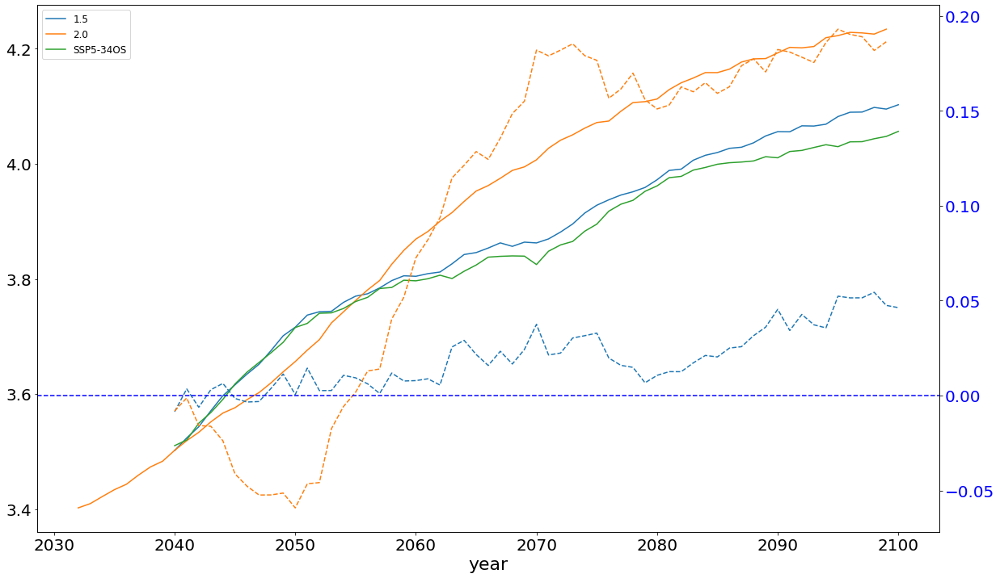

In [221]:
dscVeg15 = open_files('ncar', 'SSP534-PK', 'Lmon', GeoPK15_case, 'TOTVEGC')
dscVeg20 = open_files('ncar', 'SSP534-PK', 'Lmon', GeoPK20_case, 'TOTVEGC')
dscVeg_base = open_files('esgf', 'ssp534-over', 'Lmon', '', 'cVeg')

cVeg15_TsGBL = gm_by_area_wght(dscVeg15, 'TOTVEGC', 'avg', True, None, None)/1000.  # gC/m2 to kgC/m2
cVeg20_TsGBL = gm_by_area_wght(dscVeg20, 'TOTVEGC', 'avg', True, None, None)/1000.

cVeg_base_TsGBL = gm_by_area_wght(dscVeg_base, 'cVeg', 'avg', False, dscVeg15.area, dscVeg15.landfrac, TimeShift=False)
plot_ts_diff([cVeg15_TsGBL, cVeg20_TsGBL, cVeg_base_TsGBL], False, ['1.5', '2.0', 'SSP5-34OS'])

In [ ]:
plot_ts('ssp534', 'Lmon', 'avg', 'TLAI', 'lai', 1.0, 1.0, False, 'LAI')

In [ ]:
plot_ts('ssp534', 'Lmon', 'sum', 'NBP', 'nbp', 1.0, 1000., False, 'NBP')

In [ ]:
plot_ts('ssp534', 'Lmon', 'sum', 'NBP', 'nbp', 1.0, 1000., True, 'NBP')

In [ ]:
plot_ts('ssp534', 'Lmon', 'sum', 'HR', 'rh', 1.0, 1000., False, 'RH')

In [ ]:
plot_ts('ssp534', 'Lmon', 'sum', 'HR', 'rh', 1.0, 1000., True, 'RH')

In [ ]:
plot_ts('ssp534', 'Lmon', 'sum', 'COL_FIRE_CLOSS', 'fFire', 1.0, 1000., False, 'fFire')

In [ ]:
plot_ts('ssp534', 'Lmon', 'sum', 'COL_FIRE_CLOSS', 'fFire', 1.0, 1000., True, 'fFire')

In [ ]:
plot_ts('ssp534', 'Lmon', 'avg', 'LEAFC', 'cLeaf', 1.0, 1000.0, False, 'cLeaf')

In [ ]:
plot_ts('ssp534', 'Lmon', 'avg', 'DEADCROOTC+LIVECROOTC+FROOTC', 'cRoot', 1.0, 1000.0, False, 'cRoot', True)

In [ ]:
plot_ts('ssp534', 'Amon', 'avg', 'FSDS', 'rsds', 1.0, 1.0, False, 'rsds', True)

In [ ]:
plot_ts('ssp534', 'Amon', 'avg', 'FLDS', 'rlds', 1.0, 1.0, False, 'rlds', True)

### Figures

In [10]:
list_tas = plot_ts('ssp534', 'Amon', 'avg', 'TREFHT', 'tas', 1.0, 1.0, True, 'TAS', Vname_E3SM='TREFHT', Sca_E3SM=1.0, Fct_NCAR=-273.15, Fct_ESGF=-273.15, Fct_E3SM=-273.15, SkipPlot=True)

/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.cam.h0.TREFHT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.cam.h0.TREFHT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.cam.h0.TREFHT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/atmos_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.cam.h0.TREFHT.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/cesm2-waccm-esgf/ssp534-over/r1i1p1f1/Amon/tas/gn/v20190815/*.n

In [12]:
list_gpp = plot_ts('ssp534', 'Lmon', 'sum', 'GPP', 'gpp', 1.0, 1000.0, True, 'gpp', noLimit=True, Vname_E3SM='GPP', Sca_E3SM=-1.0, SkipPlot=True)
list_nbp = plot_ts('ssp534', 'Lmon', 'sum', 'NBP', 'nbp', 1.0, 1000.0, True, 'nbp', noLimit=True, Vname_E3SM='NEE', Sca_E3SM=-1.0, SkipPlot=True)

/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.GPP.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.GPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.GPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.GPP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/cesm2-waccm-esgf/ssp534-over/r1i1p1f1/Lmon/gpp/gn/v20190815/*.n

In [ ]:
CESM_list = [list_nbp[1], list_nbp[3], list_nbp[4]]
E3SM_list = [list_nbp[5], list_nbp[6]]
plot_ts_diff(CESM_list, True, ['ens1', 'ens2', 'base'], 'nbp', E3SM_list)

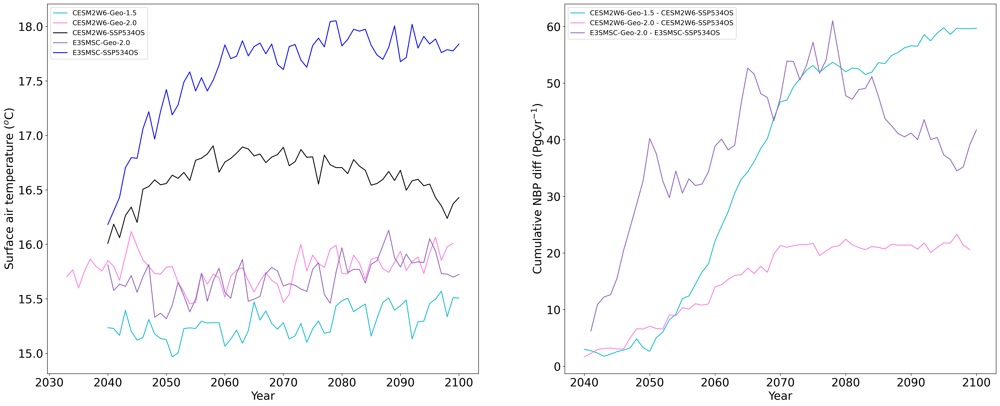

In [173]:
fig, ax = plt.subplots(1,2)

list_tas[1].plot(ax=ax[0], label='CESM2W6-Geo-1.5', color='#17becf')
list_tas[2].plot(ax=ax[0], label='CESM2W6-Geo-2.0', color='#ff7fe0')
list_tas[4].plot(ax=ax[0], label='CESM2W6-SSP534OS', color='k')
list_tas[5].plot(ax=ax[0], label='E3SMSC-Geo-2.0', color='#9467bd')
list_tas[6].plot(ax=ax[0], label='E3SMSC-SSP534OS', color='b')
ax[0].set_xlabel('Year', fontsize=20)
ax[0].set_ylabel('Surface air temperature ($^o$C)', fontsize=20)


(list_nbp[1]-list_nbp[4]).cumsum().plot(ax=ax[1], label='CESM2W6-Geo-1.5 - CESM2W6-SSP534OS', color='#17becf')
(list_nbp[2]-list_nbp[4]).cumsum().plot(ax=ax[1], label='CESM2W6-Geo-2.0 - CESM2W6-SSP534OS', color='#ff7fe0')
(list_nbp[5]-list_nbp[6])[1:].cumsum().plot(ax=ax[1], label='E3SMSC-Geo-2.0 - E3SMSC-SSP534OS', color='#9467bd')
ax[1].set_xlabel('Year', fontsize=20)
ax[1].set_ylabel('Cumulative NBP diff (PgCyr$^{-1}$)', fontsize=20)

ax[0].legend(prop={'size': 12})
ax[1].legend(prop={'size': 12})
    


In [146]:
OLevs = np.linspace(0, 1600, 11)
DLevs = np.linspace(-150, 150, 11)
list_geo_nbp_cum = plot_geomap('ssp534', 'Lmon', 'cumsum', 'NBP', 'nbp', 1.0, 1000.0, True, 'nbp', OLevs, DLevs, [2041, 2100], noLimit = False, Vname_E3SM='NEE', Sca_E3SM=-1.0, MskOcn=True, SkipPlot=True)

[   0.  160.  320.  480.  640.  800.  960. 1120. 1280. 1440. 1600.]
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.001.clm2.h0.NBP.204001-210012.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.001.clm2.h0.NBP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.15C.002.clm2.h0.NBP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_waccm/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002/land_monthly/b.e21.BWSSP534oscmip6.f09_g17.CMIP6-SSP5-3.4OS-WACCM.feedback.20C.002.clm2.h0.NBP.*.nc
/gpfs/alpine/cli137/world-shared/mxu/cesm2_w

In [ ]:
### This is a testing code (do not use)

SecName='ssp534'
areacella = open_files('esgf', SecName.lower()+'-over', 'fx', '', 'areacella')*1.e-6
sftlf = open_files('esgf', SecName.lower()+'-over', 'fx', '', 'sftlf') *1.e-2

E3SM_areacella = open_files('e3sm', SecName.lower()+'-over', 'fx', E3SM_Geo_HIST, 'areacella')*1.e-6
E3SM_sftlf = open_files('e3sm', SecName.lower()+'-over', 'fx', E3SM_Geo_HIST, 'sftlf')*1.e-2


TsGBL_e3sm_geo_cum = (-list_geo_nbp_cum[5] * E3SM_areacella.areacella.values * E3SM_sftlf.sftlf.values * 1.e-15 * 1.e6).sum(dim=("lat", "lon"))
TsGBL_e3sm_org_cum = (-list_geo_nbp_cum[6] * E3SM_areacella.areacella.values * E3SM_sftlf.sftlf.values * 1.e-15 * 1.e6).sum(dim=("lat", "lon"))

TsGBL_cesm_geo_cum = (list_geo_nbp_cum[1] * areacella.areacella.values * sftlf.sftlf.values * 1.e-15 * 1.e6).sum(dim=("lat", "lon"))
TsGBL_cesm_org_cum = (list_geo_nbp_cum[4] * areacella.areacella.values * sftlf.sftlf.values * 1.e-15 * 1.e9).sum(dim=("lat", "lon"))

print ( (-list_geo_nbp_cum[5] + list_geo_nbp_cum[6]).mean(dim=("lat", "lon")).values)
print ( (-list_geo_nbp_cum[4] + list_geo_nbp_cum[1]).mean(dim=("lat", "lon")).values)


(TsGBL_e3sm_geo_cum - TsGBL_e3sm_org_cum).plot()
(TsGBL_e3sm_geo - TsGBL_e3sm_org).cumsum().plot()
(TsGBL_cesm_geo_cum - TsGBL_cesm_org_cum).plot()


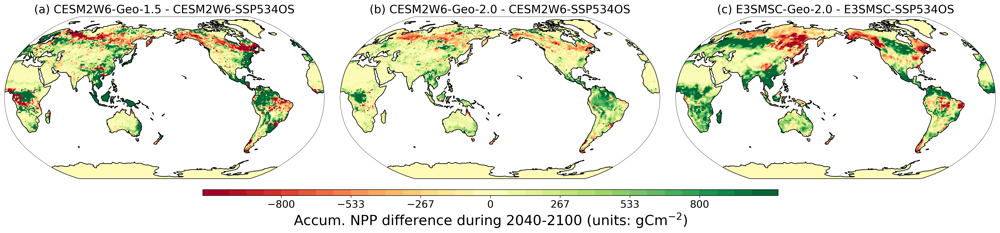

In [172]:
fig, ax = plt.subplots(1, 3, subplot_kw=dict(projection=ccrs.Robinson(central_longitude=-180.)))
fig.set_size_inches(28, 13)

OrigLevs = np.linspace(0, 1600, 11)
DiffLevs = np.linspace(-1000, 1000, 31)

MapTitles = ['(a) CESM2W6-Geo-1.5 - CESM2W6-SSP534OS', '(b) CESM2W6-Geo-2.0 - CESM2W6-SSP534OS', '(c) E3SMSC-Geo-2.0 - E3SMSC-SSP534OS']


fo1=(list_geo_nbp_cum[1] - list_geo_nbp_cum[4] * 1000.).isel(year=58).plot(ax=ax[0], transform=ccrs.PlateCarree(), add_colorbar=False, levels=DiffLevs, cmap='RdYlGn',extend='both')
(list_geo_nbp_cum[2] - list_geo_nbp_cum[4] * 1000).isel(year=58).plot(ax=ax[1], transform=ccrs.PlateCarree(), add_colorbar=False, levels=DiffLevs, cmap='RdYlGn',extend='both')
(-list_geo_nbp_cum[5] + list_geo_nbp_cum[6]).isel(year=58).plot(ax=ax[2], transform=ccrs.PlateCarree(), add_colorbar=False, levels=DiffLevs, cmap='RdYlGn',extend='both')


MaskOcean=True
for k, fax in enumerate(ax.flatten()):
 
            fax.set_xlabel('')
            fax.set_ylabel('')
            fax.set_global()
            fax.coastlines()
            
            if MaskOcean:
                fax.add_feature(cart.feature.OCEAN, zorder=100, facecolor='w')
                fax.add_feature(cart.feature.COASTLINE, zorder=200, edgecolor='k')
            fax.set_title(MapTitles[k], fontsize=18)
            

cbar_ax1 = fig.add_axes([0.28, 0.30, 0.45, 0.01])
cbar1 = fig.colorbar(fo1, cax=cbar_ax1, orientation="horizontal", extendrect=True)
cbar1.ax.tick_params(labelsize=16)
cbar1.set_label('Accum. NPP difference during 2040-2100 (units: gCm$^{-2}$)')
    
plt.subplots_adjust(hspace=0.1, wspace=0.05, bottom=0.05)


#(list_geo_nbp[1].isel(year=60) - list_geo_nbp[4].isel(year=60)).plot(ax=ax[0,0])